# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

Ya existe el subdirectorio o el archivo data.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

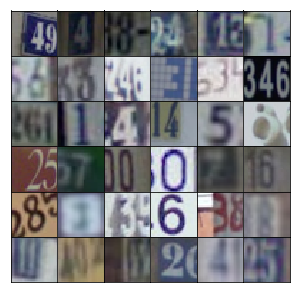

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        filters = 512
        kernel = 5
        strides = 2
        h1 = tf.layers.dense(z,4*4*filters, activation=None)
        h1 = tf.reshape(h1, [-1, 4, 4, filters])
        h1 = tf.layers.batch_normalization(h1, training=training)
        h1 = tf.maximum(alpha*h1, h1)
        # 4x4x512
        
        filters = 256

        c2 = tf.layers.conv2d_transpose(h1, filters, kernel, strides=strides, padding='same', activation=None)
        c2 = tf.layers.batch_normalization(c2, training=training)
        c2 = tf.maximum(alpha*c2, c2)
        # 8x8x256
        
        filters = 128 
        
        c3 = tf.layers.conv2d_transpose(c2, filters, kernel, strides=strides, padding='same', activation=None)
        c3 = tf.layers.batch_normalization(c3, training=training)
        c3 = tf.maximum(alpha*c3, c3)
        # 16x16x128

        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(c3, output_dim, kernel, strides=strides, padding='same', activation=None)
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2430... Generator Loss: 0.6515
Epoch 1/25... Discriminator Loss: 0.3237... Generator Loss: 3.2300
Epoch 1/25... Discriminator Loss: 0.1182... Generator Loss: 3.3257
Epoch 1/25... Discriminator Loss: 0.1247... Generator Loss: 2.9608
Epoch 1/25... Discriminator Loss: 0.1410... Generator Loss: 2.6465
Epoch 1/25... Discriminator Loss: 0.0972... Generator Loss: 3.1014
Epoch 1/25... Discriminator Loss: 0.1203... Generator Loss: 2.8933
Epoch 1/25... Discriminator Loss: 0.1439... Generator Loss: 2.8104
Epoch 1/25... Discriminator Loss: 0.1947... Generator Loss: 2.8016
Epoch 1/25... Discriminator Loss: 0.1993... Generator Loss: 2.6410


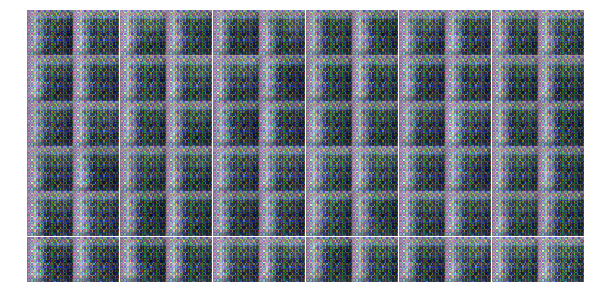

Epoch 1/25... Discriminator Loss: 0.1515... Generator Loss: 2.7521
Epoch 1/25... Discriminator Loss: 0.9260... Generator Loss: 1.1254
Epoch 1/25... Discriminator Loss: 0.5290... Generator Loss: 2.0260
Epoch 1/25... Discriminator Loss: 0.4523... Generator Loss: 1.3100
Epoch 1/25... Discriminator Loss: 0.8376... Generator Loss: 0.7797
Epoch 1/25... Discriminator Loss: 0.4316... Generator Loss: 2.2764
Epoch 1/25... Discriminator Loss: 0.5305... Generator Loss: 1.7622
Epoch 1/25... Discriminator Loss: 0.2747... Generator Loss: 3.1532
Epoch 1/25... Discriminator Loss: 0.3589... Generator Loss: 1.5809
Epoch 1/25... Discriminator Loss: 0.2481... Generator Loss: 2.4633


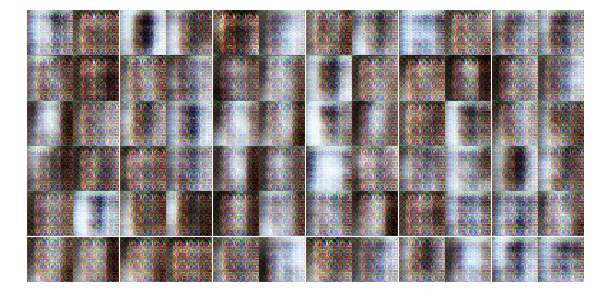

Epoch 1/25... Discriminator Loss: 0.1221... Generator Loss: 3.3113
Epoch 1/25... Discriminator Loss: 0.3949... Generator Loss: 2.0269
Epoch 1/25... Discriminator Loss: 2.0694... Generator Loss: 5.2247
Epoch 1/25... Discriminator Loss: 0.7110... Generator Loss: 0.9302
Epoch 1/25... Discriminator Loss: 0.2993... Generator Loss: 3.0991
Epoch 1/25... Discriminator Loss: 0.1792... Generator Loss: 2.8536
Epoch 1/25... Discriminator Loss: 0.8907... Generator Loss: 1.5454
Epoch 1/25... Discriminator Loss: 1.0073... Generator Loss: 0.9802
Epoch 1/25... Discriminator Loss: 1.4263... Generator Loss: 1.0418
Epoch 1/25... Discriminator Loss: 0.8724... Generator Loss: 1.4249


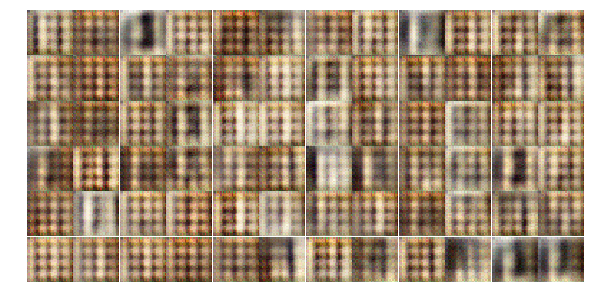

Epoch 1/25... Discriminator Loss: 0.7639... Generator Loss: 1.4581
Epoch 1/25... Discriminator Loss: 0.8057... Generator Loss: 1.3021
Epoch 1/25... Discriminator Loss: 0.6465... Generator Loss: 1.5935
Epoch 1/25... Discriminator Loss: 0.7604... Generator Loss: 1.7198
Epoch 1/25... Discriminator Loss: 0.4622... Generator Loss: 1.7101
Epoch 1/25... Discriminator Loss: 0.2819... Generator Loss: 2.6232
Epoch 1/25... Discriminator Loss: 0.4050... Generator Loss: 2.3274
Epoch 1/25... Discriminator Loss: 0.4864... Generator Loss: 2.2574
Epoch 1/25... Discriminator Loss: 0.3382... Generator Loss: 2.4122
Epoch 1/25... Discriminator Loss: 0.2899... Generator Loss: 2.2654


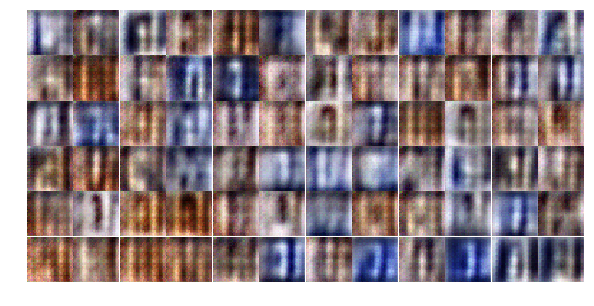

Epoch 1/25... Discriminator Loss: 0.3089... Generator Loss: 2.5337
Epoch 1/25... Discriminator Loss: 0.4738... Generator Loss: 1.5196
Epoch 1/25... Discriminator Loss: 0.4485... Generator Loss: 1.4427
Epoch 1/25... Discriminator Loss: 0.2189... Generator Loss: 3.4226
Epoch 1/25... Discriminator Loss: 1.8176... Generator Loss: 0.4888
Epoch 1/25... Discriminator Loss: 1.2383... Generator Loss: 0.7852
Epoch 1/25... Discriminator Loss: 1.0295... Generator Loss: 1.1166
Epoch 1/25... Discriminator Loss: 1.0209... Generator Loss: 0.9403
Epoch 1/25... Discriminator Loss: 0.8394... Generator Loss: 0.9226
Epoch 1/25... Discriminator Loss: 1.1262... Generator Loss: 2.6847


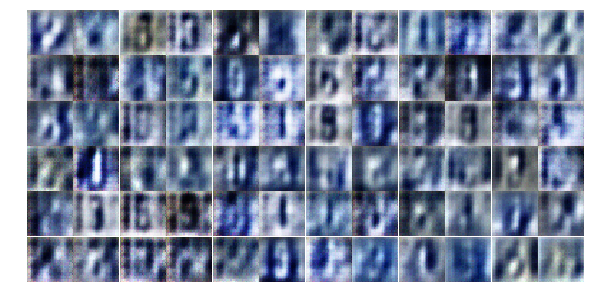

Epoch 1/25... Discriminator Loss: 0.9246... Generator Loss: 1.0687
Epoch 1/25... Discriminator Loss: 0.8023... Generator Loss: 0.9684
Epoch 1/25... Discriminator Loss: 0.4763... Generator Loss: 1.7374
Epoch 1/25... Discriminator Loss: 0.8102... Generator Loss: 0.9738
Epoch 1/25... Discriminator Loss: 0.6008... Generator Loss: 1.3865
Epoch 1/25... Discriminator Loss: 0.7557... Generator Loss: 1.1290
Epoch 1/25... Discriminator Loss: 0.6678... Generator Loss: 1.8619
Epoch 2/25... Discriminator Loss: 0.8831... Generator Loss: 1.7084
Epoch 2/25... Discriminator Loss: 0.6050... Generator Loss: 1.8586
Epoch 2/25... Discriminator Loss: 1.0943... Generator Loss: 0.7278


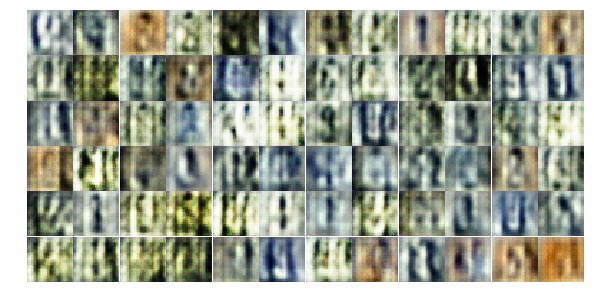

Epoch 2/25... Discriminator Loss: 0.9428... Generator Loss: 0.9685
Epoch 2/25... Discriminator Loss: 1.2017... Generator Loss: 0.6438
Epoch 2/25... Discriminator Loss: 1.0354... Generator Loss: 0.9869
Epoch 2/25... Discriminator Loss: 0.9346... Generator Loss: 1.1808
Epoch 2/25... Discriminator Loss: 0.9021... Generator Loss: 0.8939
Epoch 2/25... Discriminator Loss: 0.7333... Generator Loss: 1.5865
Epoch 2/25... Discriminator Loss: 0.9287... Generator Loss: 1.1981
Epoch 2/25... Discriminator Loss: 0.8245... Generator Loss: 1.4190
Epoch 2/25... Discriminator Loss: 0.8241... Generator Loss: 1.4694
Epoch 2/25... Discriminator Loss: 0.9345... Generator Loss: 0.9167


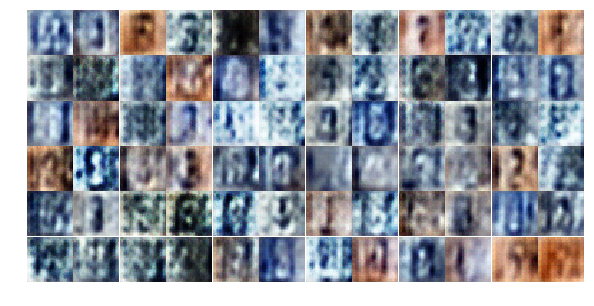

Epoch 2/25... Discriminator Loss: 0.9774... Generator Loss: 1.3063
Epoch 2/25... Discriminator Loss: 1.0594... Generator Loss: 1.5461
Epoch 2/25... Discriminator Loss: 0.9224... Generator Loss: 1.4348
Epoch 2/25... Discriminator Loss: 0.6741... Generator Loss: 1.4026
Epoch 2/25... Discriminator Loss: 0.7640... Generator Loss: 1.6166
Epoch 2/25... Discriminator Loss: 1.0106... Generator Loss: 1.2090
Epoch 2/25... Discriminator Loss: 1.1074... Generator Loss: 0.7248
Epoch 2/25... Discriminator Loss: 0.9382... Generator Loss: 1.0796
Epoch 2/25... Discriminator Loss: 0.7734... Generator Loss: 1.0798
Epoch 2/25... Discriminator Loss: 1.2065... Generator Loss: 0.5579


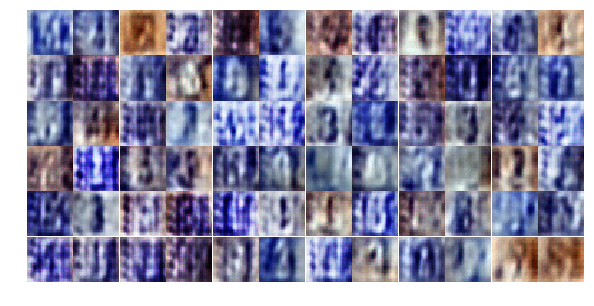

Epoch 2/25... Discriminator Loss: 0.8839... Generator Loss: 1.1387
Epoch 2/25... Discriminator Loss: 1.0503... Generator Loss: 1.2823
Epoch 2/25... Discriminator Loss: 0.6494... Generator Loss: 1.6364
Epoch 2/25... Discriminator Loss: 0.9936... Generator Loss: 1.0445
Epoch 2/25... Discriminator Loss: 0.8786... Generator Loss: 1.4455
Epoch 2/25... Discriminator Loss: 0.9388... Generator Loss: 0.9342
Epoch 2/25... Discriminator Loss: 0.7845... Generator Loss: 1.9950
Epoch 2/25... Discriminator Loss: 0.8943... Generator Loss: 0.9471
Epoch 2/25... Discriminator Loss: 0.9156... Generator Loss: 1.0170
Epoch 2/25... Discriminator Loss: 0.8396... Generator Loss: 1.3435


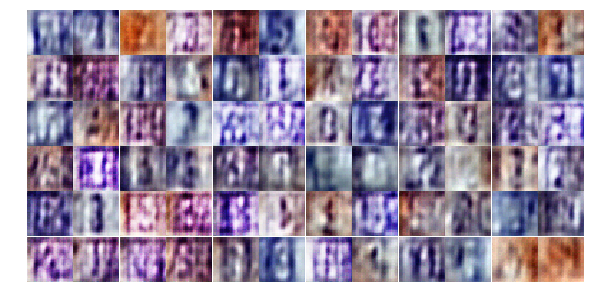

Epoch 2/25... Discriminator Loss: 1.0077... Generator Loss: 1.3347
Epoch 2/25... Discriminator Loss: 0.9647... Generator Loss: 1.1966
Epoch 2/25... Discriminator Loss: 1.1413... Generator Loss: 0.6306
Epoch 2/25... Discriminator Loss: 0.8054... Generator Loss: 1.3650
Epoch 2/25... Discriminator Loss: 0.6956... Generator Loss: 1.8190
Epoch 2/25... Discriminator Loss: 0.8136... Generator Loss: 2.0767
Epoch 2/25... Discriminator Loss: 1.3497... Generator Loss: 0.9450
Epoch 2/25... Discriminator Loss: 0.9155... Generator Loss: 1.6221
Epoch 2/25... Discriminator Loss: 0.6612... Generator Loss: 1.7928
Epoch 2/25... Discriminator Loss: 1.6803... Generator Loss: 3.0117


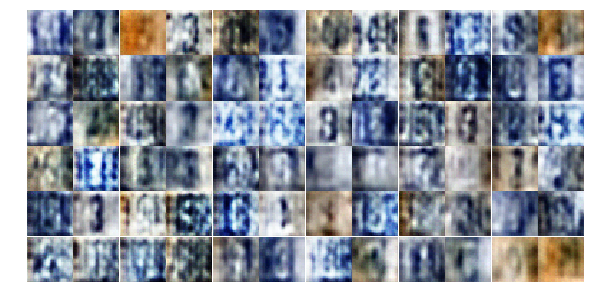

Epoch 2/25... Discriminator Loss: 0.6106... Generator Loss: 1.5306
Epoch 2/25... Discriminator Loss: 0.9549... Generator Loss: 1.1214
Epoch 2/25... Discriminator Loss: 0.7088... Generator Loss: 1.3846
Epoch 2/25... Discriminator Loss: 0.8468... Generator Loss: 1.3816
Epoch 2/25... Discriminator Loss: 1.0460... Generator Loss: 0.9183
Epoch 2/25... Discriminator Loss: 1.7560... Generator Loss: 0.2875
Epoch 2/25... Discriminator Loss: 0.7017... Generator Loss: 1.4628
Epoch 2/25... Discriminator Loss: 0.8259... Generator Loss: 2.0393
Epoch 2/25... Discriminator Loss: 0.7552... Generator Loss: 1.7266
Epoch 2/25... Discriminator Loss: 0.6888... Generator Loss: 1.6243


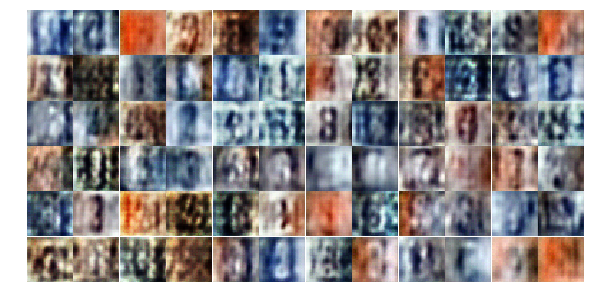

Epoch 2/25... Discriminator Loss: 1.0363... Generator Loss: 0.6963
Epoch 2/25... Discriminator Loss: 0.9139... Generator Loss: 1.0541
Epoch 2/25... Discriminator Loss: 1.4507... Generator Loss: 0.3704
Epoch 2/25... Discriminator Loss: 0.9975... Generator Loss: 0.9243
Epoch 3/25... Discriminator Loss: 0.5825... Generator Loss: 2.1891
Epoch 3/25... Discriminator Loss: 0.4041... Generator Loss: 1.8256
Epoch 3/25... Discriminator Loss: 1.0599... Generator Loss: 0.7837
Epoch 3/25... Discriminator Loss: 0.3496... Generator Loss: 2.0665
Epoch 3/25... Discriminator Loss: 0.7677... Generator Loss: 1.4953
Epoch 3/25... Discriminator Loss: 1.4097... Generator Loss: 0.4469


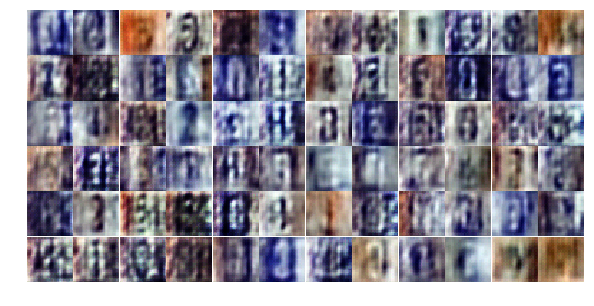

Epoch 3/25... Discriminator Loss: 0.3435... Generator Loss: 1.8875
Epoch 3/25... Discriminator Loss: 0.5179... Generator Loss: 1.3982
Epoch 3/25... Discriminator Loss: 0.6826... Generator Loss: 1.5225
Epoch 3/25... Discriminator Loss: 0.4248... Generator Loss: 1.9041
Epoch 3/25... Discriminator Loss: 1.2156... Generator Loss: 0.7333
Epoch 3/25... Discriminator Loss: 1.2182... Generator Loss: 0.6450
Epoch 3/25... Discriminator Loss: 0.6461... Generator Loss: 2.2655
Epoch 3/25... Discriminator Loss: 0.6705... Generator Loss: 1.9927
Epoch 3/25... Discriminator Loss: 1.3089... Generator Loss: 0.5419
Epoch 3/25... Discriminator Loss: 0.8406... Generator Loss: 0.8636


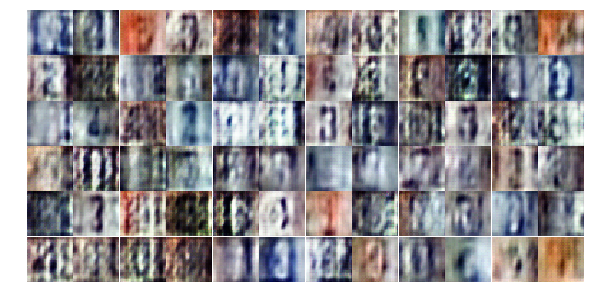

Epoch 3/25... Discriminator Loss: 0.5144... Generator Loss: 1.6766
Epoch 3/25... Discriminator Loss: 0.7233... Generator Loss: 0.9777
Epoch 3/25... Discriminator Loss: 1.6944... Generator Loss: 3.4265
Epoch 3/25... Discriminator Loss: 0.8466... Generator Loss: 1.5244
Epoch 3/25... Discriminator Loss: 0.8945... Generator Loss: 1.0129
Epoch 3/25... Discriminator Loss: 0.8381... Generator Loss: 0.8242
Epoch 3/25... Discriminator Loss: 0.4290... Generator Loss: 1.5909
Epoch 3/25... Discriminator Loss: 0.4893... Generator Loss: 1.5266
Epoch 3/25... Discriminator Loss: 0.8773... Generator Loss: 0.8595
Epoch 3/25... Discriminator Loss: 0.8986... Generator Loss: 0.8385


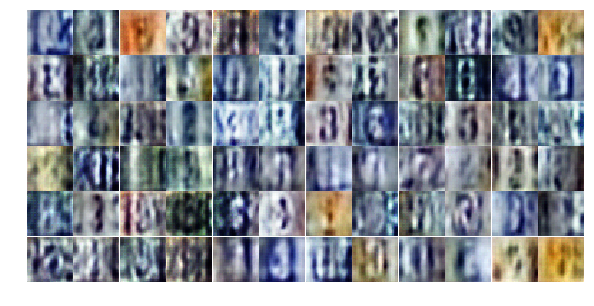

Epoch 3/25... Discriminator Loss: 0.7996... Generator Loss: 1.4994
Epoch 3/25... Discriminator Loss: 0.4758... Generator Loss: 1.6361
Epoch 3/25... Discriminator Loss: 0.5347... Generator Loss: 1.1546
Epoch 3/25... Discriminator Loss: 0.5478... Generator Loss: 1.2937
Epoch 3/25... Discriminator Loss: 1.3193... Generator Loss: 0.4882
Epoch 3/25... Discriminator Loss: 0.5938... Generator Loss: 1.1614
Epoch 3/25... Discriminator Loss: 0.3325... Generator Loss: 2.3079
Epoch 3/25... Discriminator Loss: 0.4219... Generator Loss: 3.0178
Epoch 3/25... Discriminator Loss: 1.1462... Generator Loss: 0.9310
Epoch 3/25... Discriminator Loss: 1.2353... Generator Loss: 0.5888


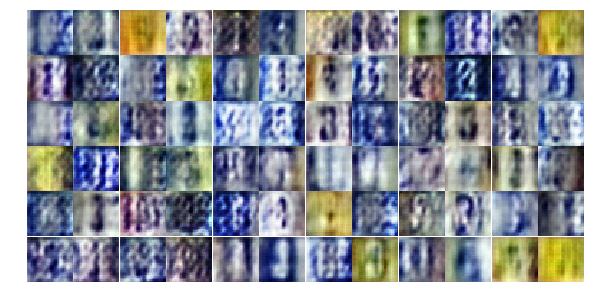

Epoch 3/25... Discriminator Loss: 0.7566... Generator Loss: 2.2204
Epoch 3/25... Discriminator Loss: 0.4689... Generator Loss: 1.9026
Epoch 3/25... Discriminator Loss: 1.4964... Generator Loss: 0.4320
Epoch 3/25... Discriminator Loss: 0.4718... Generator Loss: 1.4690
Epoch 3/25... Discriminator Loss: 0.6060... Generator Loss: 2.3654
Epoch 3/25... Discriminator Loss: 0.9198... Generator Loss: 0.7038
Epoch 3/25... Discriminator Loss: 1.0961... Generator Loss: 1.0750
Epoch 3/25... Discriminator Loss: 0.4601... Generator Loss: 2.8163
Epoch 3/25... Discriminator Loss: 0.3904... Generator Loss: 1.9810
Epoch 3/25... Discriminator Loss: 1.4164... Generator Loss: 0.3938


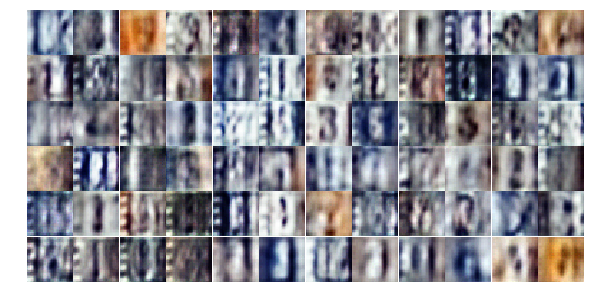

Epoch 3/25... Discriminator Loss: 0.8069... Generator Loss: 0.9571
Epoch 3/25... Discriminator Loss: 0.6929... Generator Loss: 0.9839
Epoch 3/25... Discriminator Loss: 1.0201... Generator Loss: 0.6908
Epoch 3/25... Discriminator Loss: 0.5137... Generator Loss: 1.3550
Epoch 3/25... Discriminator Loss: 0.5117... Generator Loss: 1.4112
Epoch 3/25... Discriminator Loss: 0.2490... Generator Loss: 2.8012
Epoch 3/25... Discriminator Loss: 0.5275... Generator Loss: 1.5071
Epoch 3/25... Discriminator Loss: 0.5012... Generator Loss: 1.4191
Epoch 3/25... Discriminator Loss: 0.3906... Generator Loss: 1.7592
Epoch 3/25... Discriminator Loss: 0.9131... Generator Loss: 0.7378


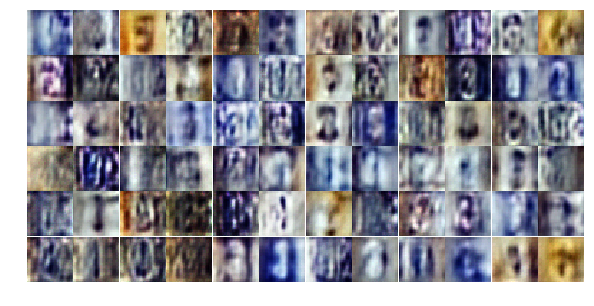

Epoch 3/25... Discriminator Loss: 1.5986... Generator Loss: 0.3493
Epoch 4/25... Discriminator Loss: 1.4817... Generator Loss: 0.4079
Epoch 4/25... Discriminator Loss: 1.2643... Generator Loss: 0.5202
Epoch 4/25... Discriminator Loss: 0.3309... Generator Loss: 2.4187
Epoch 4/25... Discriminator Loss: 0.3532... Generator Loss: 2.0088
Epoch 4/25... Discriminator Loss: 0.5122... Generator Loss: 1.4493
Epoch 4/25... Discriminator Loss: 0.7806... Generator Loss: 3.5952
Epoch 4/25... Discriminator Loss: 0.5110... Generator Loss: 1.5994
Epoch 4/25... Discriminator Loss: 1.4193... Generator Loss: 2.1184
Epoch 4/25... Discriminator Loss: 1.1035... Generator Loss: 1.1304


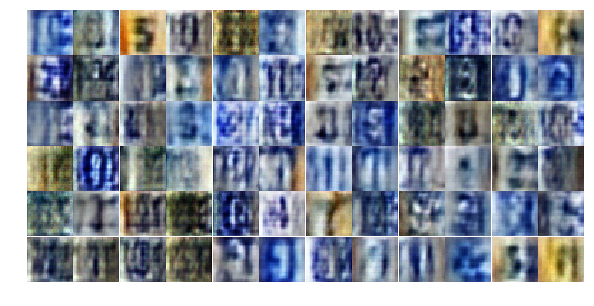

Epoch 4/25... Discriminator Loss: 1.1413... Generator Loss: 0.6271
Epoch 4/25... Discriminator Loss: 0.8584... Generator Loss: 2.6344
Epoch 4/25... Discriminator Loss: 1.0073... Generator Loss: 0.7548
Epoch 4/25... Discriminator Loss: 1.2143... Generator Loss: 2.0017
Epoch 4/25... Discriminator Loss: 0.8987... Generator Loss: 1.1935
Epoch 4/25... Discriminator Loss: 0.6904... Generator Loss: 1.0535
Epoch 4/25... Discriminator Loss: 0.7958... Generator Loss: 0.8863
Epoch 4/25... Discriminator Loss: 0.7570... Generator Loss: 0.8739
Epoch 4/25... Discriminator Loss: 1.0960... Generator Loss: 0.6162
Epoch 4/25... Discriminator Loss: 1.1693... Generator Loss: 2.2335


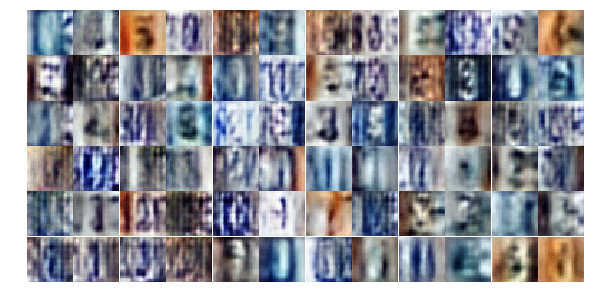

Epoch 4/25... Discriminator Loss: 0.7724... Generator Loss: 1.4924
Epoch 4/25... Discriminator Loss: 1.3041... Generator Loss: 2.3894
Epoch 4/25... Discriminator Loss: 0.5611... Generator Loss: 1.3776
Epoch 4/25... Discriminator Loss: 0.8471... Generator Loss: 0.9530
Epoch 4/25... Discriminator Loss: 0.4808... Generator Loss: 1.4725
Epoch 4/25... Discriminator Loss: 0.5236... Generator Loss: 2.2356
Epoch 4/25... Discriminator Loss: 0.6676... Generator Loss: 1.4362
Epoch 4/25... Discriminator Loss: 0.6393... Generator Loss: 1.3313
Epoch 4/25... Discriminator Loss: 0.4520... Generator Loss: 1.6427
Epoch 4/25... Discriminator Loss: 0.5619... Generator Loss: 1.4185


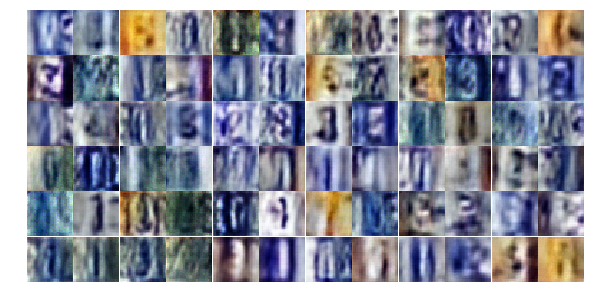

Epoch 4/25... Discriminator Loss: 0.3257... Generator Loss: 2.0571
Epoch 4/25... Discriminator Loss: 0.6255... Generator Loss: 1.1684
Epoch 4/25... Discriminator Loss: 0.5219... Generator Loss: 1.4180
Epoch 4/25... Discriminator Loss: 0.4244... Generator Loss: 1.7695
Epoch 4/25... Discriminator Loss: 0.4030... Generator Loss: 1.6255
Epoch 4/25... Discriminator Loss: 0.5451... Generator Loss: 1.4520
Epoch 4/25... Discriminator Loss: 0.9391... Generator Loss: 0.9414
Epoch 4/25... Discriminator Loss: 0.8602... Generator Loss: 1.5194
Epoch 4/25... Discriminator Loss: 1.0253... Generator Loss: 0.6400
Epoch 4/25... Discriminator Loss: 0.4357... Generator Loss: 1.8888


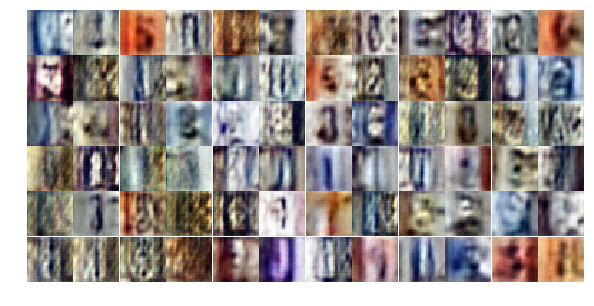

Epoch 4/25... Discriminator Loss: 0.5131... Generator Loss: 1.3681
Epoch 4/25... Discriminator Loss: 0.5454... Generator Loss: 1.5303
Epoch 4/25... Discriminator Loss: 0.6056... Generator Loss: 1.8685
Epoch 4/25... Discriminator Loss: 0.8586... Generator Loss: 0.8990
Epoch 4/25... Discriminator Loss: 0.4272... Generator Loss: 3.2790
Epoch 4/25... Discriminator Loss: 0.7956... Generator Loss: 1.0267
Epoch 4/25... Discriminator Loss: 0.3316... Generator Loss: 2.0183
Epoch 4/25... Discriminator Loss: 1.1777... Generator Loss: 0.6475
Epoch 4/25... Discriminator Loss: 0.5567... Generator Loss: 1.3212
Epoch 4/25... Discriminator Loss: 0.6165... Generator Loss: 1.7526


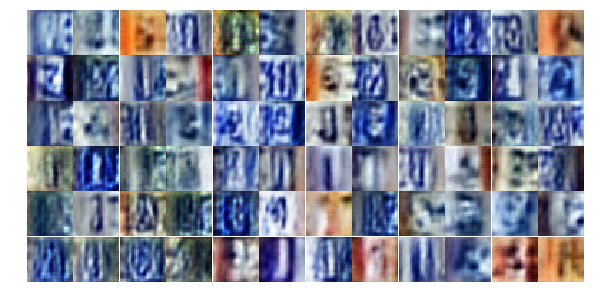

Epoch 4/25... Discriminator Loss: 0.3570... Generator Loss: 2.3148
Epoch 4/25... Discriminator Loss: 0.9169... Generator Loss: 3.6919
Epoch 4/25... Discriminator Loss: 0.8147... Generator Loss: 1.2741
Epoch 4/25... Discriminator Loss: 0.9645... Generator Loss: 0.7832
Epoch 4/25... Discriminator Loss: 0.6633... Generator Loss: 1.0843
Epoch 4/25... Discriminator Loss: 0.6184... Generator Loss: 2.3216
Epoch 4/25... Discriminator Loss: 0.9939... Generator Loss: 0.6381
Epoch 4/25... Discriminator Loss: 0.5449... Generator Loss: 1.2716
Epoch 4/25... Discriminator Loss: 0.6399... Generator Loss: 1.0964
Epoch 5/25... Discriminator Loss: 0.3770... Generator Loss: 1.7441


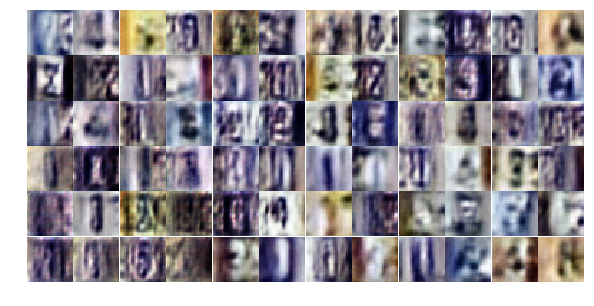

Epoch 5/25... Discriminator Loss: 0.4486... Generator Loss: 1.5234
Epoch 5/25... Discriminator Loss: 0.8620... Generator Loss: 0.8149
Epoch 5/25... Discriminator Loss: 0.5325... Generator Loss: 1.3216
Epoch 5/25... Discriminator Loss: 0.6106... Generator Loss: 1.0013
Epoch 5/25... Discriminator Loss: 0.4020... Generator Loss: 1.9618
Epoch 5/25... Discriminator Loss: 1.2989... Generator Loss: 0.4375
Epoch 5/25... Discriminator Loss: 0.5196... Generator Loss: 1.4655
Epoch 5/25... Discriminator Loss: 0.5586... Generator Loss: 1.5447
Epoch 5/25... Discriminator Loss: 0.5405... Generator Loss: 1.5568
Epoch 5/25... Discriminator Loss: 0.5636... Generator Loss: 1.1404


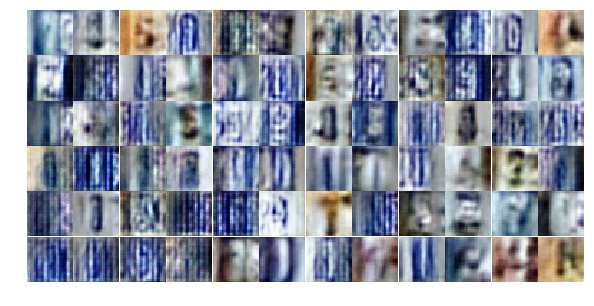

Epoch 5/25... Discriminator Loss: 0.9416... Generator Loss: 1.7303
Epoch 5/25... Discriminator Loss: 0.4787... Generator Loss: 1.4401
Epoch 5/25... Discriminator Loss: 0.5074... Generator Loss: 1.8519
Epoch 5/25... Discriminator Loss: 0.6263... Generator Loss: 1.2699
Epoch 5/25... Discriminator Loss: 0.5568... Generator Loss: 1.2731
Epoch 5/25... Discriminator Loss: 1.2387... Generator Loss: 0.5006
Epoch 5/25... Discriminator Loss: 0.3377... Generator Loss: 2.3808
Epoch 5/25... Discriminator Loss: 0.4419... Generator Loss: 2.4153
Epoch 5/25... Discriminator Loss: 0.6894... Generator Loss: 0.9881
Epoch 5/25... Discriminator Loss: 0.4982... Generator Loss: 1.6106


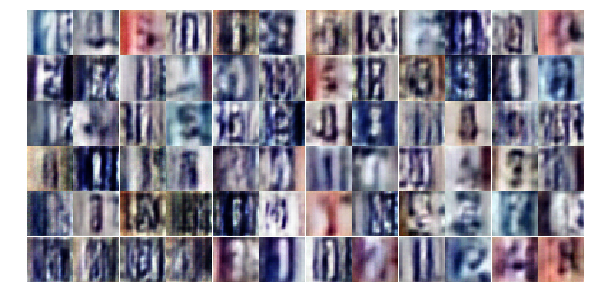

Epoch 5/25... Discriminator Loss: 0.5149... Generator Loss: 1.9136
Epoch 5/25... Discriminator Loss: 0.4638... Generator Loss: 2.1209
Epoch 5/25... Discriminator Loss: 0.3642... Generator Loss: 1.8632
Epoch 5/25... Discriminator Loss: 0.3965... Generator Loss: 1.6420
Epoch 5/25... Discriminator Loss: 2.7273... Generator Loss: 0.1219
Epoch 5/25... Discriminator Loss: 0.8571... Generator Loss: 0.7949
Epoch 5/25... Discriminator Loss: 0.7457... Generator Loss: 0.9040
Epoch 5/25... Discriminator Loss: 0.4225... Generator Loss: 1.8138
Epoch 5/25... Discriminator Loss: 0.7523... Generator Loss: 0.9023
Epoch 5/25... Discriminator Loss: 0.3550... Generator Loss: 1.9651


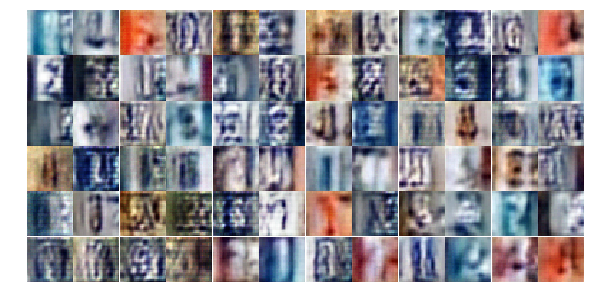

Epoch 5/25... Discriminator Loss: 0.5978... Generator Loss: 1.1462
Epoch 5/25... Discriminator Loss: 0.5330... Generator Loss: 1.4914
Epoch 5/25... Discriminator Loss: 0.5634... Generator Loss: 2.1289
Epoch 5/25... Discriminator Loss: 0.4725... Generator Loss: 2.2690
Epoch 5/25... Discriminator Loss: 0.7127... Generator Loss: 1.5571
Epoch 5/25... Discriminator Loss: 0.6756... Generator Loss: 1.0283
Epoch 5/25... Discriminator Loss: 0.9982... Generator Loss: 0.6676
Epoch 5/25... Discriminator Loss: 0.4157... Generator Loss: 1.6927
Epoch 5/25... Discriminator Loss: 0.5042... Generator Loss: 1.2922
Epoch 5/25... Discriminator Loss: 0.3282... Generator Loss: 1.9751


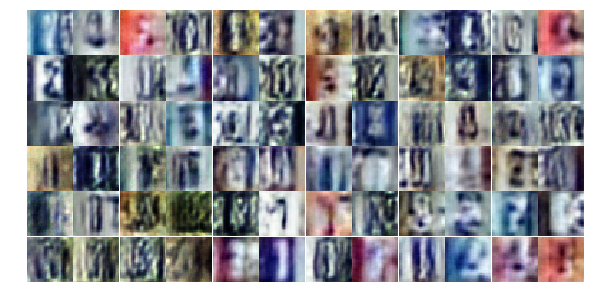

Epoch 5/25... Discriminator Loss: 0.3715... Generator Loss: 1.7017
Epoch 5/25... Discriminator Loss: 0.4667... Generator Loss: 1.2156
Epoch 5/25... Discriminator Loss: 2.4716... Generator Loss: 0.1743
Epoch 5/25... Discriminator Loss: 0.9013... Generator Loss: 0.8594
Epoch 5/25... Discriminator Loss: 1.2751... Generator Loss: 0.4927
Epoch 5/25... Discriminator Loss: 0.8701... Generator Loss: 0.8074
Epoch 5/25... Discriminator Loss: 0.5466... Generator Loss: 1.3524
Epoch 5/25... Discriminator Loss: 0.4856... Generator Loss: 1.9064
Epoch 5/25... Discriminator Loss: 1.3796... Generator Loss: 0.4005
Epoch 5/25... Discriminator Loss: 1.2722... Generator Loss: 3.0451


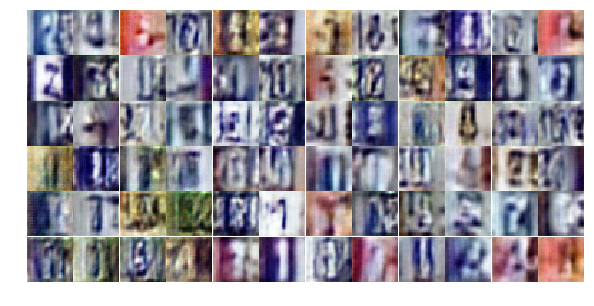

Epoch 5/25... Discriminator Loss: 1.1106... Generator Loss: 0.6408
Epoch 5/25... Discriminator Loss: 0.6394... Generator Loss: 1.3117
Epoch 5/25... Discriminator Loss: 0.7266... Generator Loss: 0.9252
Epoch 5/25... Discriminator Loss: 0.5636... Generator Loss: 1.2229
Epoch 5/25... Discriminator Loss: 0.5637... Generator Loss: 1.3429
Epoch 5/25... Discriminator Loss: 0.6581... Generator Loss: 2.2859
Epoch 6/25... Discriminator Loss: 0.4720... Generator Loss: 1.4993
Epoch 6/25... Discriminator Loss: 0.2628... Generator Loss: 2.1712
Epoch 6/25... Discriminator Loss: 1.5539... Generator Loss: 0.6197
Epoch 6/25... Discriminator Loss: 0.8834... Generator Loss: 0.8876


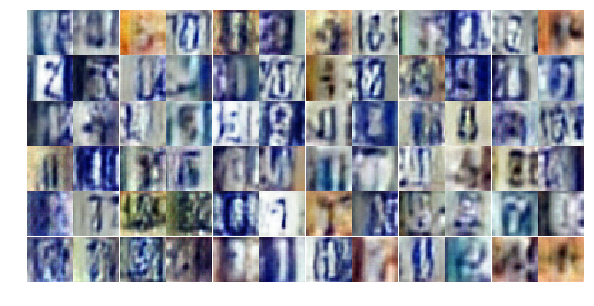

Epoch 6/25... Discriminator Loss: 0.6128... Generator Loss: 1.1408
Epoch 6/25... Discriminator Loss: 1.1554... Generator Loss: 0.4974
Epoch 6/25... Discriminator Loss: 0.5126... Generator Loss: 1.5305
Epoch 6/25... Discriminator Loss: 0.8546... Generator Loss: 0.7541
Epoch 6/25... Discriminator Loss: 0.6129... Generator Loss: 1.0705
Epoch 6/25... Discriminator Loss: 0.4152... Generator Loss: 1.5601
Epoch 6/25... Discriminator Loss: 0.9137... Generator Loss: 0.8084
Epoch 6/25... Discriminator Loss: 0.6250... Generator Loss: 1.2229
Epoch 6/25... Discriminator Loss: 0.4976... Generator Loss: 1.3402
Epoch 6/25... Discriminator Loss: 0.4245... Generator Loss: 1.4799


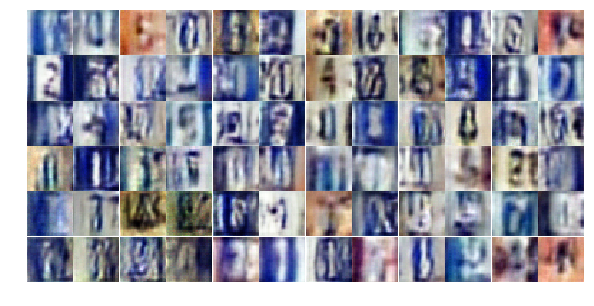

Epoch 6/25... Discriminator Loss: 0.7879... Generator Loss: 0.8722
Epoch 6/25... Discriminator Loss: 0.5134... Generator Loss: 1.9781
Epoch 6/25... Discriminator Loss: 2.7386... Generator Loss: 0.2457
Epoch 6/25... Discriminator Loss: 0.4253... Generator Loss: 1.7328
Epoch 6/25... Discriminator Loss: 0.4632... Generator Loss: 1.3669
Epoch 6/25... Discriminator Loss: 0.3661... Generator Loss: 1.7209
Epoch 6/25... Discriminator Loss: 0.2727... Generator Loss: 2.1031
Epoch 6/25... Discriminator Loss: 0.5756... Generator Loss: 1.2454
Epoch 6/25... Discriminator Loss: 1.3841... Generator Loss: 3.6977
Epoch 6/25... Discriminator Loss: 0.5588... Generator Loss: 1.4629


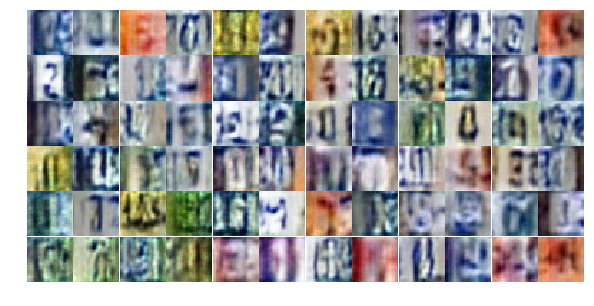

Epoch 6/25... Discriminator Loss: 0.9364... Generator Loss: 0.6344
Epoch 6/25... Discriminator Loss: 1.0474... Generator Loss: 2.7386
Epoch 6/25... Discriminator Loss: 1.5475... Generator Loss: 0.3532
Epoch 6/25... Discriminator Loss: 0.7339... Generator Loss: 3.3794
Epoch 6/25... Discriminator Loss: 0.6301... Generator Loss: 3.1649
Epoch 6/25... Discriminator Loss: 1.0564... Generator Loss: 0.5768
Epoch 6/25... Discriminator Loss: 0.5398... Generator Loss: 1.4812
Epoch 6/25... Discriminator Loss: 0.3417... Generator Loss: 1.9247
Epoch 6/25... Discriminator Loss: 0.5628... Generator Loss: 1.4398
Epoch 6/25... Discriminator Loss: 0.3475... Generator Loss: 1.7116


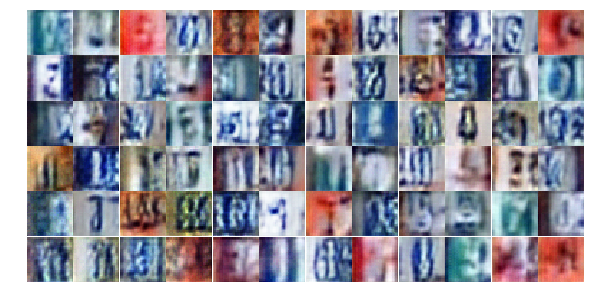

Epoch 6/25... Discriminator Loss: 0.9686... Generator Loss: 0.7075
Epoch 6/25... Discriminator Loss: 0.6348... Generator Loss: 1.0448
Epoch 6/25... Discriminator Loss: 0.6923... Generator Loss: 0.9990
Epoch 6/25... Discriminator Loss: 0.7726... Generator Loss: 0.8294
Epoch 6/25... Discriminator Loss: 1.0626... Generator Loss: 0.5600
Epoch 6/25... Discriminator Loss: 0.6942... Generator Loss: 1.0807
Epoch 6/25... Discriminator Loss: 0.6666... Generator Loss: 1.0971
Epoch 6/25... Discriminator Loss: 0.3734... Generator Loss: 1.6935
Epoch 6/25... Discriminator Loss: 0.7155... Generator Loss: 0.9988
Epoch 6/25... Discriminator Loss: 0.2025... Generator Loss: 2.1231


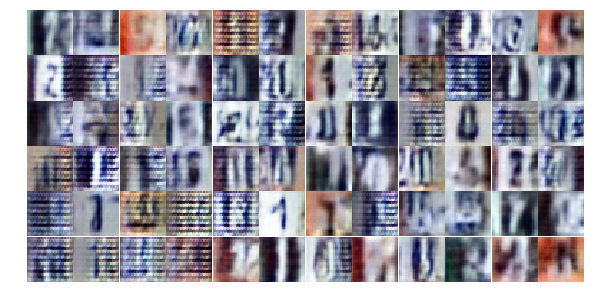

Epoch 6/25... Discriminator Loss: 0.6964... Generator Loss: 1.0451
Epoch 6/25... Discriminator Loss: 0.9861... Generator Loss: 0.8313
Epoch 6/25... Discriminator Loss: 0.8993... Generator Loss: 0.8198
Epoch 6/25... Discriminator Loss: 0.7206... Generator Loss: 1.5854
Epoch 6/25... Discriminator Loss: 0.5772... Generator Loss: 1.4694
Epoch 6/25... Discriminator Loss: 0.6590... Generator Loss: 1.1070
Epoch 6/25... Discriminator Loss: 0.5820... Generator Loss: 1.3324
Epoch 6/25... Discriminator Loss: 1.7745... Generator Loss: 0.2535
Epoch 6/25... Discriminator Loss: 0.5827... Generator Loss: 2.0161
Epoch 6/25... Discriminator Loss: 0.9096... Generator Loss: 0.7379


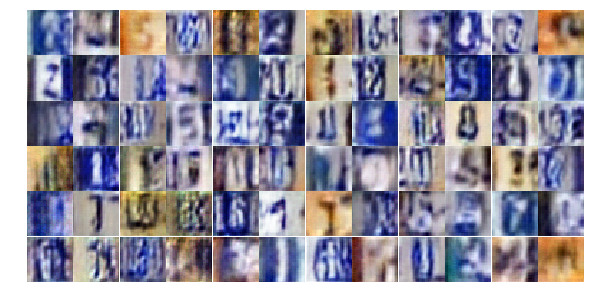

Epoch 6/25... Discriminator Loss: 0.5090... Generator Loss: 1.2597
Epoch 6/25... Discriminator Loss: 0.3850... Generator Loss: 1.6935
Epoch 6/25... Discriminator Loss: 0.6905... Generator Loss: 1.3983
Epoch 7/25... Discriminator Loss: 0.4801... Generator Loss: 1.4647
Epoch 7/25... Discriminator Loss: 0.7136... Generator Loss: 0.8983
Epoch 7/25... Discriminator Loss: 0.6984... Generator Loss: 1.1854
Epoch 7/25... Discriminator Loss: 0.2187... Generator Loss: 2.3776
Epoch 7/25... Discriminator Loss: 1.6756... Generator Loss: 0.3448
Epoch 7/25... Discriminator Loss: 0.4810... Generator Loss: 1.4310
Epoch 7/25... Discriminator Loss: 1.6772... Generator Loss: 0.2901


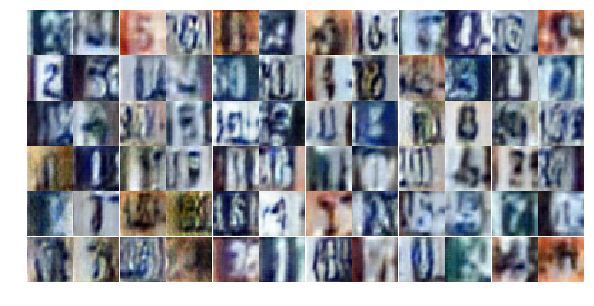

Epoch 7/25... Discriminator Loss: 0.8622... Generator Loss: 1.8164
Epoch 7/25... Discriminator Loss: 0.7170... Generator Loss: 0.9917
Epoch 7/25... Discriminator Loss: 0.9643... Generator Loss: 0.7530
Epoch 7/25... Discriminator Loss: 0.3640... Generator Loss: 1.6119
Epoch 7/25... Discriminator Loss: 1.0129... Generator Loss: 0.7100
Epoch 7/25... Discriminator Loss: 0.4379... Generator Loss: 1.5419
Epoch 7/25... Discriminator Loss: 0.4882... Generator Loss: 1.7234
Epoch 7/25... Discriminator Loss: 0.4335... Generator Loss: 1.9740
Epoch 7/25... Discriminator Loss: 0.6037... Generator Loss: 2.5786
Epoch 7/25... Discriminator Loss: 0.7104... Generator Loss: 0.9942


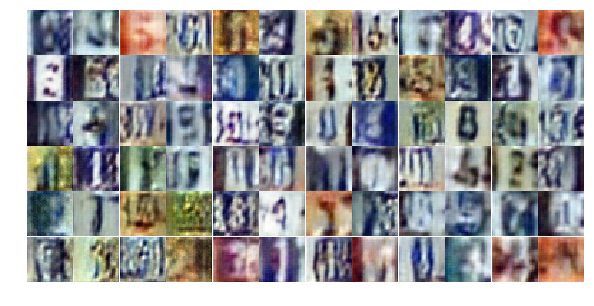

Epoch 7/25... Discriminator Loss: 0.5113... Generator Loss: 1.3863
Epoch 7/25... Discriminator Loss: 0.4292... Generator Loss: 1.7038
Epoch 7/25... Discriminator Loss: 1.0589... Generator Loss: 0.5776
Epoch 7/25... Discriminator Loss: 0.5997... Generator Loss: 1.5943
Epoch 7/25... Discriminator Loss: 0.5457... Generator Loss: 1.1911
Epoch 7/25... Discriminator Loss: 0.4116... Generator Loss: 2.1943
Epoch 7/25... Discriminator Loss: 0.6994... Generator Loss: 1.1283
Epoch 7/25... Discriminator Loss: 1.1245... Generator Loss: 0.6079
Epoch 7/25... Discriminator Loss: 0.2680... Generator Loss: 2.2958
Epoch 7/25... Discriminator Loss: 0.4977... Generator Loss: 1.2943


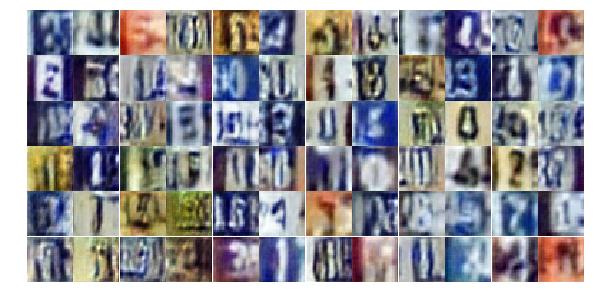

Epoch 7/25... Discriminator Loss: 1.0628... Generator Loss: 0.5658
Epoch 7/25... Discriminator Loss: 1.0323... Generator Loss: 0.6378
Epoch 7/25... Discriminator Loss: 0.4795... Generator Loss: 1.7152
Epoch 7/25... Discriminator Loss: 0.5836... Generator Loss: 1.1674
Epoch 7/25... Discriminator Loss: 0.5165... Generator Loss: 1.3135
Epoch 7/25... Discriminator Loss: 0.8260... Generator Loss: 0.7638
Epoch 7/25... Discriminator Loss: 0.3916... Generator Loss: 1.6662
Epoch 7/25... Discriminator Loss: 0.8082... Generator Loss: 0.8194
Epoch 7/25... Discriminator Loss: 2.1347... Generator Loss: 0.1790
Epoch 7/25... Discriminator Loss: 0.5041... Generator Loss: 1.8711


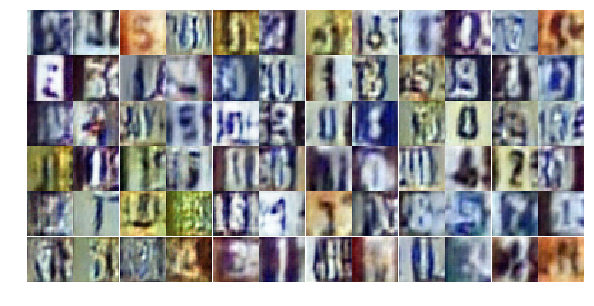

Epoch 7/25... Discriminator Loss: 0.8180... Generator Loss: 0.8723
Epoch 7/25... Discriminator Loss: 0.9403... Generator Loss: 0.6918
Epoch 7/25... Discriminator Loss: 0.4444... Generator Loss: 1.8343
Epoch 7/25... Discriminator Loss: 0.4647... Generator Loss: 1.7606
Epoch 7/25... Discriminator Loss: 0.6823... Generator Loss: 0.9131
Epoch 7/25... Discriminator Loss: 0.4991... Generator Loss: 1.3736
Epoch 7/25... Discriminator Loss: 0.4599... Generator Loss: 1.4293
Epoch 7/25... Discriminator Loss: 0.7908... Generator Loss: 0.8884
Epoch 7/25... Discriminator Loss: 0.4075... Generator Loss: 3.2032
Epoch 7/25... Discriminator Loss: 0.8427... Generator Loss: 0.8883


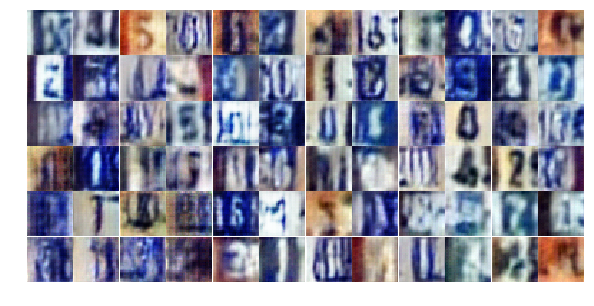

Epoch 7/25... Discriminator Loss: 0.4236... Generator Loss: 1.6213
Epoch 7/25... Discriminator Loss: 0.6532... Generator Loss: 1.0688
Epoch 7/25... Discriminator Loss: 0.8629... Generator Loss: 0.7493
Epoch 7/25... Discriminator Loss: 0.5267... Generator Loss: 1.2125
Epoch 7/25... Discriminator Loss: 0.4662... Generator Loss: 1.3324
Epoch 7/25... Discriminator Loss: 0.5520... Generator Loss: 1.4354
Epoch 7/25... Discriminator Loss: 1.1854... Generator Loss: 0.5054
Epoch 7/25... Discriminator Loss: 0.7056... Generator Loss: 1.2291
Epoch 7/25... Discriminator Loss: 0.6592... Generator Loss: 1.1254
Epoch 7/25... Discriminator Loss: 0.4432... Generator Loss: 1.3324


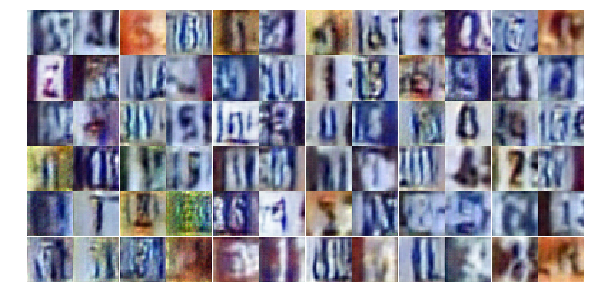

Epoch 7/25... Discriminator Loss: 0.4062... Generator Loss: 1.9475
Epoch 8/25... Discriminator Loss: 0.5130... Generator Loss: 1.3037
Epoch 8/25... Discriminator Loss: 1.2764... Generator Loss: 0.4195
Epoch 8/25... Discriminator Loss: 0.9689... Generator Loss: 0.6778
Epoch 8/25... Discriminator Loss: 0.5910... Generator Loss: 1.8011
Epoch 8/25... Discriminator Loss: 0.8505... Generator Loss: 1.2255
Epoch 8/25... Discriminator Loss: 0.8381... Generator Loss: 0.7731
Epoch 8/25... Discriminator Loss: 1.6357... Generator Loss: 5.4054
Epoch 8/25... Discriminator Loss: 0.7356... Generator Loss: 1.2498
Epoch 8/25... Discriminator Loss: 0.7207... Generator Loss: 1.0156


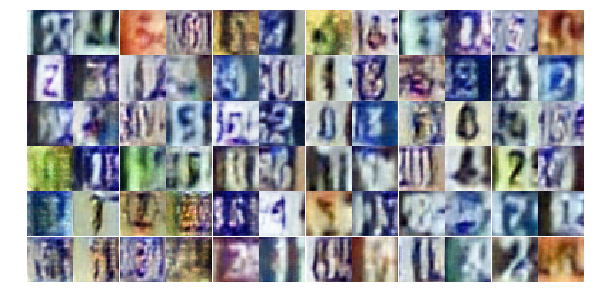

Epoch 8/25... Discriminator Loss: 0.4233... Generator Loss: 1.9288
Epoch 8/25... Discriminator Loss: 0.3993... Generator Loss: 1.6605
Epoch 8/25... Discriminator Loss: 0.6743... Generator Loss: 0.9817
Epoch 8/25... Discriminator Loss: 0.3919... Generator Loss: 1.8604
Epoch 8/25... Discriminator Loss: 0.6719... Generator Loss: 1.8773
Epoch 8/25... Discriminator Loss: 1.2267... Generator Loss: 1.6583
Epoch 8/25... Discriminator Loss: 0.4426... Generator Loss: 2.4993
Epoch 8/25... Discriminator Loss: 0.3389... Generator Loss: 1.9133
Epoch 8/25... Discriminator Loss: 0.5674... Generator Loss: 1.4510
Epoch 8/25... Discriminator Loss: 1.1102... Generator Loss: 0.5941


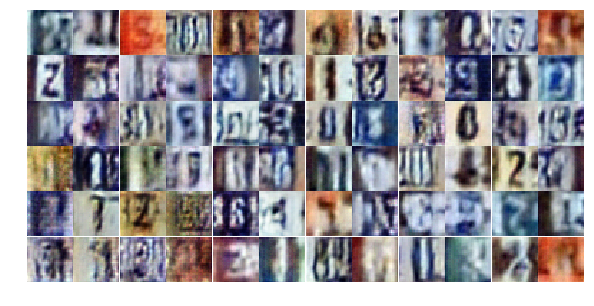

Epoch 8/25... Discriminator Loss: 0.3957... Generator Loss: 1.6919
Epoch 8/25... Discriminator Loss: 0.4673... Generator Loss: 1.4816
Epoch 8/25... Discriminator Loss: 0.9356... Generator Loss: 0.7586
Epoch 8/25... Discriminator Loss: 0.6842... Generator Loss: 1.9352
Epoch 8/25... Discriminator Loss: 0.3315... Generator Loss: 2.0514
Epoch 8/25... Discriminator Loss: 0.4544... Generator Loss: 1.7360
Epoch 8/25... Discriminator Loss: 0.7909... Generator Loss: 1.6590
Epoch 8/25... Discriminator Loss: 0.6284... Generator Loss: 1.0240
Epoch 8/25... Discriminator Loss: 0.8247... Generator Loss: 2.0795
Epoch 8/25... Discriminator Loss: 0.5242... Generator Loss: 1.4089


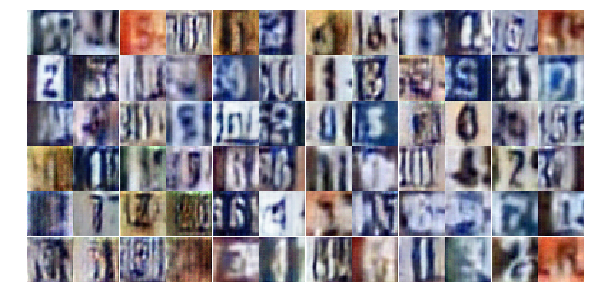

Epoch 8/25... Discriminator Loss: 0.6297... Generator Loss: 1.2132
Epoch 8/25... Discriminator Loss: 1.2202... Generator Loss: 0.4906
Epoch 8/25... Discriminator Loss: 0.4681... Generator Loss: 1.4560
Epoch 8/25... Discriminator Loss: 0.6077... Generator Loss: 1.1149
Epoch 8/25... Discriminator Loss: 0.6780... Generator Loss: 0.9170
Epoch 8/25... Discriminator Loss: 0.3213... Generator Loss: 2.0000
Epoch 8/25... Discriminator Loss: 0.4305... Generator Loss: 1.4456
Epoch 8/25... Discriminator Loss: 0.7600... Generator Loss: 0.8699
Epoch 8/25... Discriminator Loss: 0.5383... Generator Loss: 1.5279
Epoch 8/25... Discriminator Loss: 0.2051... Generator Loss: 2.8592


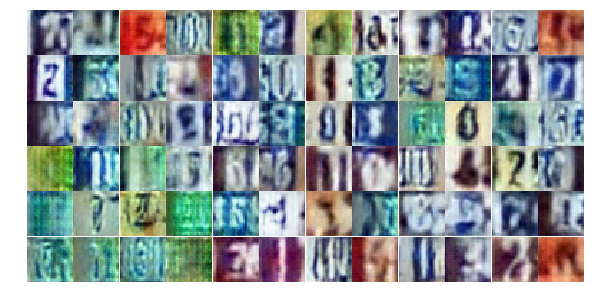

Epoch 8/25... Discriminator Loss: 0.3832... Generator Loss: 1.5617
Epoch 8/25... Discriminator Loss: 0.6279... Generator Loss: 1.1038
Epoch 8/25... Discriminator Loss: 0.3701... Generator Loss: 1.5550
Epoch 8/25... Discriminator Loss: 0.5226... Generator Loss: 1.6005
Epoch 8/25... Discriminator Loss: 2.9697... Generator Loss: 4.3593
Epoch 8/25... Discriminator Loss: 1.1812... Generator Loss: 0.8653
Epoch 8/25... Discriminator Loss: 0.5287... Generator Loss: 3.5736
Epoch 8/25... Discriminator Loss: 0.4967... Generator Loss: 1.7746
Epoch 8/25... Discriminator Loss: 0.5390... Generator Loss: 1.3427
Epoch 8/25... Discriminator Loss: 0.6010... Generator Loss: 1.3068


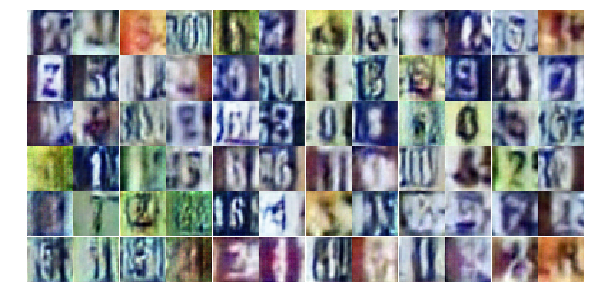

Epoch 8/25... Discriminator Loss: 0.5581... Generator Loss: 1.2248
Epoch 8/25... Discriminator Loss: 0.4662... Generator Loss: 1.8518
Epoch 8/25... Discriminator Loss: 0.5119... Generator Loss: 2.1206
Epoch 8/25... Discriminator Loss: 0.7966... Generator Loss: 0.8257
Epoch 8/25... Discriminator Loss: 0.3412... Generator Loss: 2.3096
Epoch 8/25... Discriminator Loss: 0.9614... Generator Loss: 0.6589
Epoch 8/25... Discriminator Loss: 0.4885... Generator Loss: 1.2396
Epoch 8/25... Discriminator Loss: 0.6363... Generator Loss: 2.7492
Epoch 9/25... Discriminator Loss: 0.9576... Generator Loss: 1.3061
Epoch 9/25... Discriminator Loss: 0.8084... Generator Loss: 0.8036


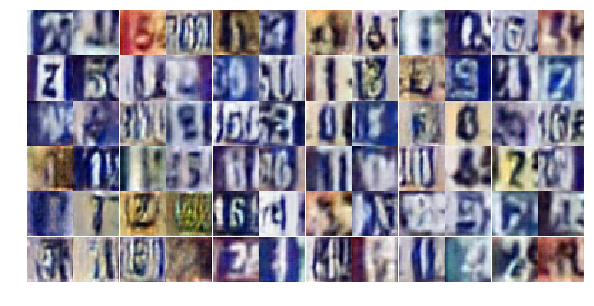

Epoch 9/25... Discriminator Loss: 0.7847... Generator Loss: 0.8640
Epoch 9/25... Discriminator Loss: 0.4843... Generator Loss: 1.3994
Epoch 9/25... Discriminator Loss: 0.8200... Generator Loss: 0.8291
Epoch 9/25... Discriminator Loss: 0.3318... Generator Loss: 2.1746
Epoch 9/25... Discriminator Loss: 1.3696... Generator Loss: 0.4082
Epoch 9/25... Discriminator Loss: 0.5108... Generator Loss: 2.3613
Epoch 9/25... Discriminator Loss: 0.5846... Generator Loss: 1.2091
Epoch 9/25... Discriminator Loss: 0.5774... Generator Loss: 1.1526
Epoch 9/25... Discriminator Loss: 0.7313... Generator Loss: 0.8814
Epoch 9/25... Discriminator Loss: 0.5150... Generator Loss: 1.4692


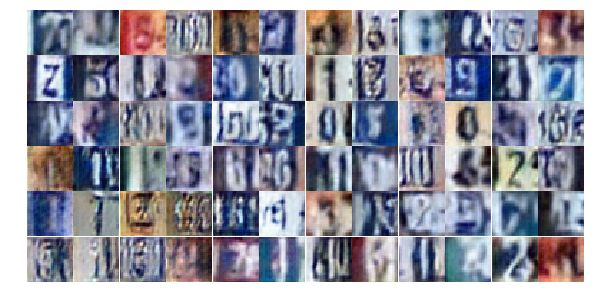

Epoch 9/25... Discriminator Loss: 0.7255... Generator Loss: 1.0619
Epoch 9/25... Discriminator Loss: 1.2179... Generator Loss: 0.5255
Epoch 9/25... Discriminator Loss: 0.5330... Generator Loss: 1.2823
Epoch 9/25... Discriminator Loss: 0.8218... Generator Loss: 0.8734
Epoch 9/25... Discriminator Loss: 0.6084... Generator Loss: 2.7460
Epoch 9/25... Discriminator Loss: 0.6604... Generator Loss: 1.2658
Epoch 9/25... Discriminator Loss: 0.9589... Generator Loss: 0.6792
Epoch 9/25... Discriminator Loss: 0.7421... Generator Loss: 0.8713
Epoch 9/25... Discriminator Loss: 0.9364... Generator Loss: 0.6549
Epoch 9/25... Discriminator Loss: 0.7588... Generator Loss: 0.8610


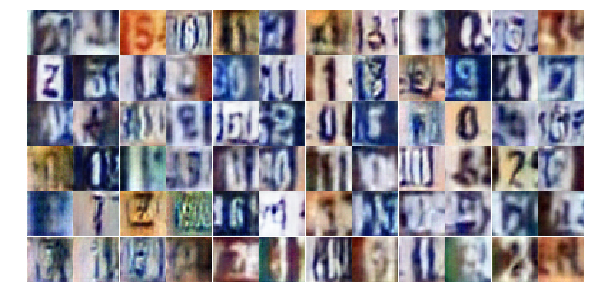

Epoch 9/25... Discriminator Loss: 1.1593... Generator Loss: 0.5661
Epoch 9/25... Discriminator Loss: 0.5559... Generator Loss: 1.2992
Epoch 9/25... Discriminator Loss: 0.7828... Generator Loss: 2.2560
Epoch 9/25... Discriminator Loss: 0.6709... Generator Loss: 0.9495
Epoch 9/25... Discriminator Loss: 0.5562... Generator Loss: 1.2622
Epoch 9/25... Discriminator Loss: 0.3311... Generator Loss: 1.7129
Epoch 9/25... Discriminator Loss: 1.2532... Generator Loss: 0.4382
Epoch 9/25... Discriminator Loss: 0.5819... Generator Loss: 1.8038
Epoch 9/25... Discriminator Loss: 0.4218... Generator Loss: 1.4531
Epoch 9/25... Discriminator Loss: 0.6489... Generator Loss: 0.9612


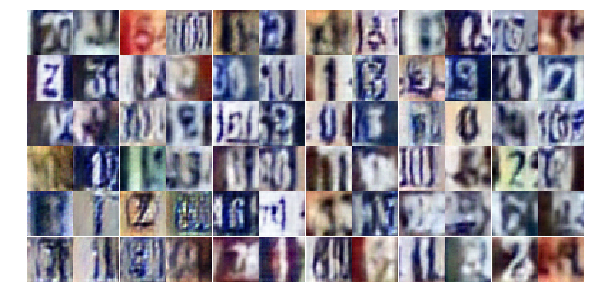

Epoch 9/25... Discriminator Loss: 0.6137... Generator Loss: 1.1027
Epoch 9/25... Discriminator Loss: 0.4269... Generator Loss: 1.8066
Epoch 9/25... Discriminator Loss: 1.1018... Generator Loss: 0.5390
Epoch 9/25... Discriminator Loss: 0.7621... Generator Loss: 0.9490
Epoch 9/25... Discriminator Loss: 0.6775... Generator Loss: 1.0999
Epoch 9/25... Discriminator Loss: 0.5228... Generator Loss: 1.6932
Epoch 9/25... Discriminator Loss: 0.9217... Generator Loss: 2.5491
Epoch 9/25... Discriminator Loss: 0.4182... Generator Loss: 1.3896
Epoch 9/25... Discriminator Loss: 0.6664... Generator Loss: 1.0721
Epoch 9/25... Discriminator Loss: 0.6100... Generator Loss: 1.0464


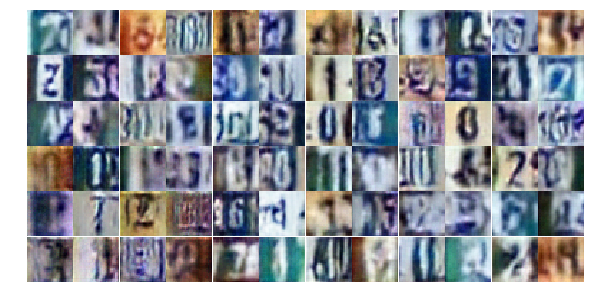

Epoch 9/25... Discriminator Loss: 0.5880... Generator Loss: 1.1486
Epoch 9/25... Discriminator Loss: 0.4544... Generator Loss: 1.5615
Epoch 9/25... Discriminator Loss: 0.5377... Generator Loss: 1.6482
Epoch 9/25... Discriminator Loss: 0.8029... Generator Loss: 0.9382
Epoch 9/25... Discriminator Loss: 0.3252... Generator Loss: 1.9673
Epoch 9/25... Discriminator Loss: 1.1019... Generator Loss: 0.5422
Epoch 9/25... Discriminator Loss: 0.7822... Generator Loss: 0.8752
Epoch 9/25... Discriminator Loss: 0.4549... Generator Loss: 1.4531
Epoch 9/25... Discriminator Loss: 0.4410... Generator Loss: 2.2866
Epoch 9/25... Discriminator Loss: 0.5756... Generator Loss: 2.1025


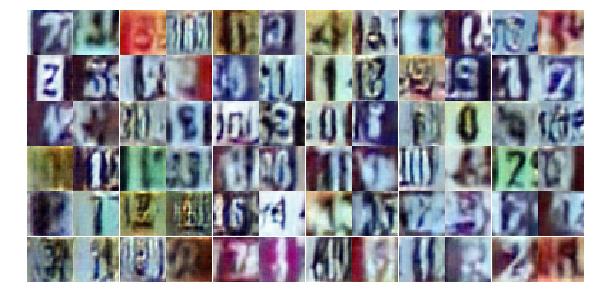

Epoch 9/25... Discriminator Loss: 1.1852... Generator Loss: 0.6041
Epoch 9/25... Discriminator Loss: 0.6903... Generator Loss: 2.2501
Epoch 9/25... Discriminator Loss: 0.4784... Generator Loss: 1.5997
Epoch 9/25... Discriminator Loss: 1.1271... Generator Loss: 0.5172
Epoch 9/25... Discriminator Loss: 0.5116... Generator Loss: 1.6101
Epoch 10/25... Discriminator Loss: 0.8091... Generator Loss: 0.8285
Epoch 10/25... Discriminator Loss: 0.5103... Generator Loss: 1.5824
Epoch 10/25... Discriminator Loss: 0.5560... Generator Loss: 1.2298
Epoch 10/25... Discriminator Loss: 0.6685... Generator Loss: 2.1655
Epoch 10/25... Discriminator Loss: 1.2478... Generator Loss: 0.4449


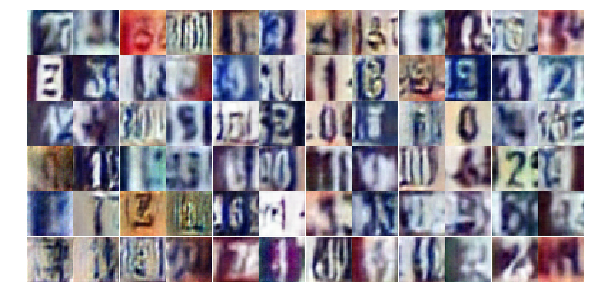

Epoch 10/25... Discriminator Loss: 0.5808... Generator Loss: 1.0768
Epoch 10/25... Discriminator Loss: 0.5751... Generator Loss: 1.2408
Epoch 10/25... Discriminator Loss: 0.8361... Generator Loss: 2.2721
Epoch 10/25... Discriminator Loss: 0.7093... Generator Loss: 1.6890
Epoch 10/25... Discriminator Loss: 0.4067... Generator Loss: 1.6517
Epoch 10/25... Discriminator Loss: 0.5589... Generator Loss: 1.2831
Epoch 10/25... Discriminator Loss: 0.5212... Generator Loss: 1.2611
Epoch 10/25... Discriminator Loss: 0.8506... Generator Loss: 0.8125
Epoch 10/25... Discriminator Loss: 3.2490... Generator Loss: 0.0721
Epoch 10/25... Discriminator Loss: 0.6162... Generator Loss: 1.5206


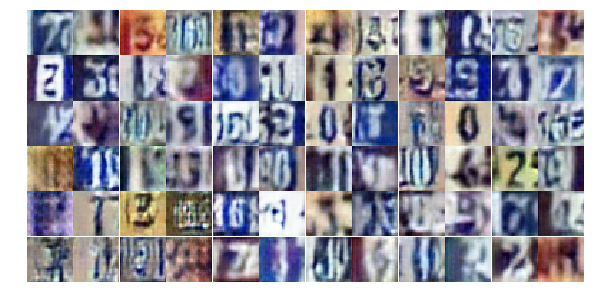

Epoch 10/25... Discriminator Loss: 1.5605... Generator Loss: 0.3824
Epoch 10/25... Discriminator Loss: 0.9447... Generator Loss: 0.8004
Epoch 10/25... Discriminator Loss: 0.8728... Generator Loss: 0.7390
Epoch 10/25... Discriminator Loss: 0.9853... Generator Loss: 0.6169
Epoch 10/25... Discriminator Loss: 0.5712... Generator Loss: 1.2577
Epoch 10/25... Discriminator Loss: 0.4851... Generator Loss: 1.3960
Epoch 10/25... Discriminator Loss: 0.7600... Generator Loss: 0.8293
Epoch 10/25... Discriminator Loss: 0.4900... Generator Loss: 1.3836
Epoch 10/25... Discriminator Loss: 0.6022... Generator Loss: 1.3099
Epoch 10/25... Discriminator Loss: 0.4680... Generator Loss: 2.6286


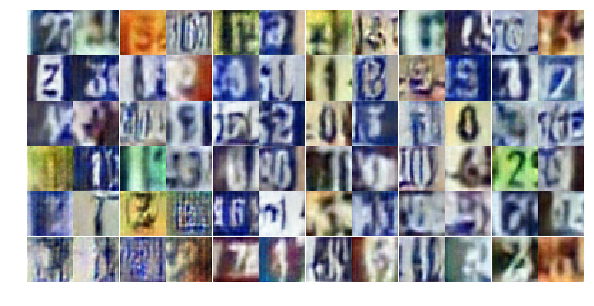

Epoch 10/25... Discriminator Loss: 1.2608... Generator Loss: 0.4687
Epoch 10/25... Discriminator Loss: 0.5542... Generator Loss: 1.3097
Epoch 10/25... Discriminator Loss: 0.4152... Generator Loss: 1.6028
Epoch 10/25... Discriminator Loss: 0.4694... Generator Loss: 1.6430
Epoch 10/25... Discriminator Loss: 1.7301... Generator Loss: 0.2851
Epoch 10/25... Discriminator Loss: 0.6120... Generator Loss: 1.0281
Epoch 10/25... Discriminator Loss: 0.3555... Generator Loss: 1.9695
Epoch 10/25... Discriminator Loss: 1.1204... Generator Loss: 0.5409
Epoch 10/25... Discriminator Loss: 0.7106... Generator Loss: 0.8735
Epoch 10/25... Discriminator Loss: 1.0142... Generator Loss: 0.6395


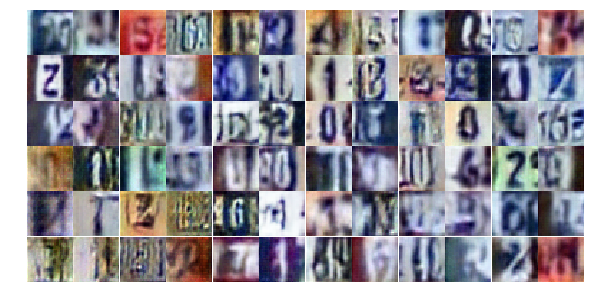

Epoch 10/25... Discriminator Loss: 0.8032... Generator Loss: 2.3760
Epoch 10/25... Discriminator Loss: 0.6001... Generator Loss: 1.3026
Epoch 10/25... Discriminator Loss: 0.4805... Generator Loss: 1.4221
Epoch 10/25... Discriminator Loss: 0.4576... Generator Loss: 1.7202
Epoch 10/25... Discriminator Loss: 0.6599... Generator Loss: 0.9896
Epoch 10/25... Discriminator Loss: 0.7991... Generator Loss: 0.8396
Epoch 10/25... Discriminator Loss: 0.6902... Generator Loss: 0.9971
Epoch 10/25... Discriminator Loss: 1.0923... Generator Loss: 0.6316
Epoch 10/25... Discriminator Loss: 0.5361... Generator Loss: 1.2136
Epoch 10/25... Discriminator Loss: 0.7794... Generator Loss: 2.4054


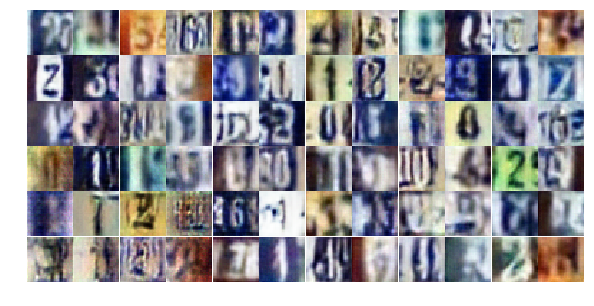

Epoch 10/25... Discriminator Loss: 0.7923... Generator Loss: 0.8964
Epoch 10/25... Discriminator Loss: 0.6200... Generator Loss: 1.2683
Epoch 10/25... Discriminator Loss: 1.0261... Generator Loss: 0.5569
Epoch 10/25... Discriminator Loss: 0.5389... Generator Loss: 1.8833
Epoch 10/25... Discriminator Loss: 0.4338... Generator Loss: 1.5756
Epoch 10/25... Discriminator Loss: 0.5768... Generator Loss: 1.2181
Epoch 10/25... Discriminator Loss: 0.4202... Generator Loss: 1.5506
Epoch 10/25... Discriminator Loss: 0.4240... Generator Loss: 1.5833
Epoch 10/25... Discriminator Loss: 0.8932... Generator Loss: 2.7056
Epoch 10/25... Discriminator Loss: 0.6663... Generator Loss: 1.2136


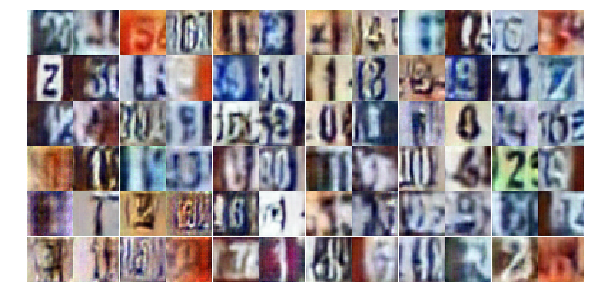

Epoch 10/25... Discriminator Loss: 0.5459... Generator Loss: 1.6823
Epoch 10/25... Discriminator Loss: 0.4354... Generator Loss: 1.4685
Epoch 10/25... Discriminator Loss: 0.5591... Generator Loss: 1.1483
Epoch 11/25... Discriminator Loss: 0.6379... Generator Loss: 1.1753
Epoch 11/25... Discriminator Loss: 0.5672... Generator Loss: 1.1136
Epoch 11/25... Discriminator Loss: 1.6190... Generator Loss: 0.3517
Epoch 11/25... Discriminator Loss: 0.5746... Generator Loss: 1.1317
Epoch 11/25... Discriminator Loss: 0.5989... Generator Loss: 1.9117
Epoch 11/25... Discriminator Loss: 1.4094... Generator Loss: 0.4750
Epoch 11/25... Discriminator Loss: 0.4249... Generator Loss: 1.7992


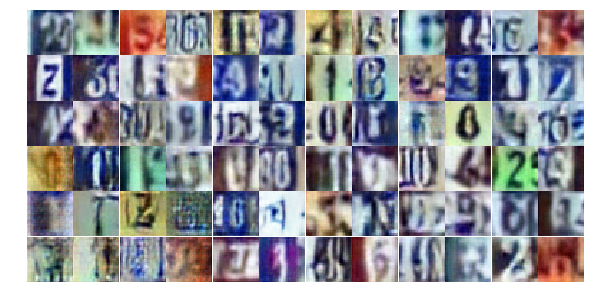

Epoch 11/25... Discriminator Loss: 0.3771... Generator Loss: 1.8687
Epoch 11/25... Discriminator Loss: 0.6178... Generator Loss: 1.1584
Epoch 11/25... Discriminator Loss: 0.4776... Generator Loss: 1.3428
Epoch 11/25... Discriminator Loss: 0.8315... Generator Loss: 0.7990
Epoch 11/25... Discriminator Loss: 0.5863... Generator Loss: 1.3254
Epoch 11/25... Discriminator Loss: 0.4553... Generator Loss: 1.6006
Epoch 11/25... Discriminator Loss: 0.5641... Generator Loss: 1.4146
Epoch 11/25... Discriminator Loss: 0.3333... Generator Loss: 2.1371
Epoch 11/25... Discriminator Loss: 0.6409... Generator Loss: 1.0043
Epoch 11/25... Discriminator Loss: 1.3014... Generator Loss: 0.4711


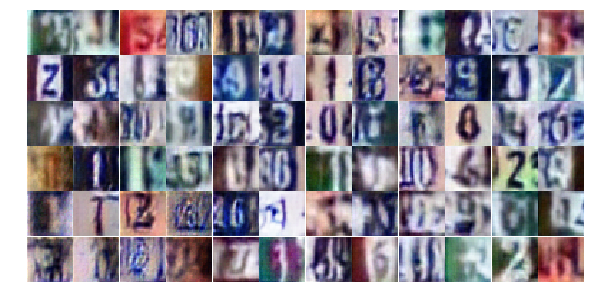

Epoch 11/25... Discriminator Loss: 0.6251... Generator Loss: 1.0887
Epoch 11/25... Discriminator Loss: 0.3919... Generator Loss: 2.3238
Epoch 11/25... Discriminator Loss: 0.8410... Generator Loss: 0.7796
Epoch 11/25... Discriminator Loss: 0.8721... Generator Loss: 0.7667
Epoch 11/25... Discriminator Loss: 0.3931... Generator Loss: 1.7313
Epoch 11/25... Discriminator Loss: 0.2800... Generator Loss: 2.2395
Epoch 11/25... Discriminator Loss: 0.7143... Generator Loss: 1.5742
Epoch 11/25... Discriminator Loss: 2.3979... Generator Loss: 0.1797
Epoch 11/25... Discriminator Loss: 0.5616... Generator Loss: 2.1652
Epoch 11/25... Discriminator Loss: 1.1422... Generator Loss: 0.5011


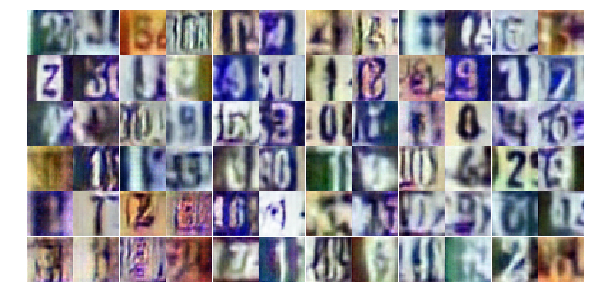

Epoch 11/25... Discriminator Loss: 0.7090... Generator Loss: 1.0224
Epoch 11/25... Discriminator Loss: 0.6786... Generator Loss: 1.0183
Epoch 11/25... Discriminator Loss: 0.7000... Generator Loss: 1.0781
Epoch 11/25... Discriminator Loss: 0.4766... Generator Loss: 1.3519
Epoch 11/25... Discriminator Loss: 0.6202... Generator Loss: 1.0725
Epoch 11/25... Discriminator Loss: 1.2015... Generator Loss: 0.4863
Epoch 11/25... Discriminator Loss: 1.5138... Generator Loss: 0.3431
Epoch 11/25... Discriminator Loss: 1.9315... Generator Loss: 2.2107
Epoch 11/25... Discriminator Loss: 0.5496... Generator Loss: 1.4435
Epoch 11/25... Discriminator Loss: 1.0042... Generator Loss: 0.7187


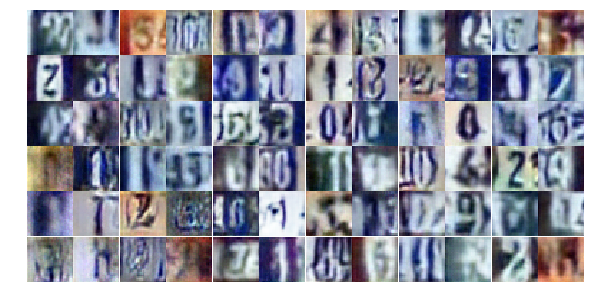

Epoch 11/25... Discriminator Loss: 0.6052... Generator Loss: 1.1797
Epoch 11/25... Discriminator Loss: 0.5893... Generator Loss: 1.2385
Epoch 11/25... Discriminator Loss: 0.6587... Generator Loss: 1.1923
Epoch 11/25... Discriminator Loss: 0.6646... Generator Loss: 1.3031
Epoch 11/25... Discriminator Loss: 0.9868... Generator Loss: 0.6128
Epoch 11/25... Discriminator Loss: 0.6873... Generator Loss: 1.4006
Epoch 11/25... Discriminator Loss: 0.2541... Generator Loss: 3.1135
Epoch 11/25... Discriminator Loss: 0.7554... Generator Loss: 1.1569
Epoch 11/25... Discriminator Loss: 1.3267... Generator Loss: 0.4160
Epoch 11/25... Discriminator Loss: 0.5610... Generator Loss: 1.8402


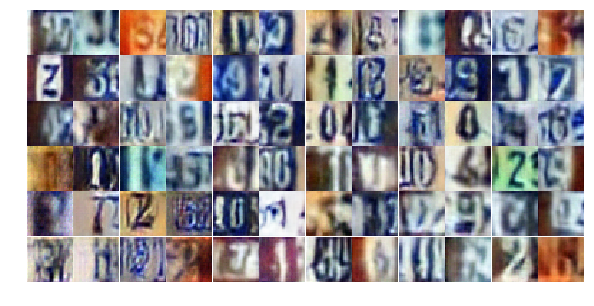

Epoch 11/25... Discriminator Loss: 0.7931... Generator Loss: 0.8734
Epoch 11/25... Discriminator Loss: 0.3047... Generator Loss: 2.1114
Epoch 11/25... Discriminator Loss: 0.6725... Generator Loss: 1.0713
Epoch 11/25... Discriminator Loss: 0.5918... Generator Loss: 1.0973
Epoch 11/25... Discriminator Loss: 1.1457... Generator Loss: 0.5708
Epoch 11/25... Discriminator Loss: 1.1056... Generator Loss: 0.5499
Epoch 11/25... Discriminator Loss: 0.6625... Generator Loss: 1.1705
Epoch 11/25... Discriminator Loss: 0.4834... Generator Loss: 1.3921
Epoch 11/25... Discriminator Loss: 1.1453... Generator Loss: 0.5638
Epoch 11/25... Discriminator Loss: 0.9719... Generator Loss: 0.8073


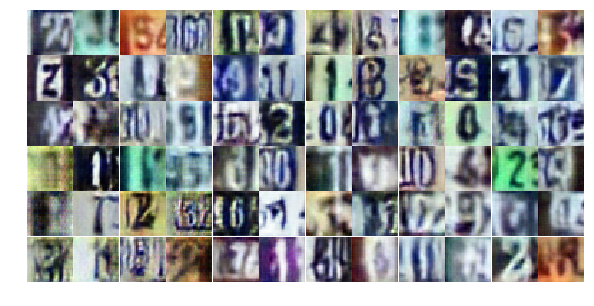

Epoch 12/25... Discriminator Loss: 0.6813... Generator Loss: 1.0823
Epoch 12/25... Discriminator Loss: 0.6190... Generator Loss: 1.2069
Epoch 12/25... Discriminator Loss: 1.0572... Generator Loss: 0.6482
Epoch 12/25... Discriminator Loss: 0.4753... Generator Loss: 1.4596
Epoch 12/25... Discriminator Loss: 0.2891... Generator Loss: 2.1886
Epoch 12/25... Discriminator Loss: 0.9663... Generator Loss: 0.6740
Epoch 12/25... Discriminator Loss: 0.5973... Generator Loss: 1.3582
Epoch 12/25... Discriminator Loss: 0.5493... Generator Loss: 1.2239
Epoch 12/25... Discriminator Loss: 0.7937... Generator Loss: 0.9439
Epoch 12/25... Discriminator Loss: 1.2315... Generator Loss: 0.4881


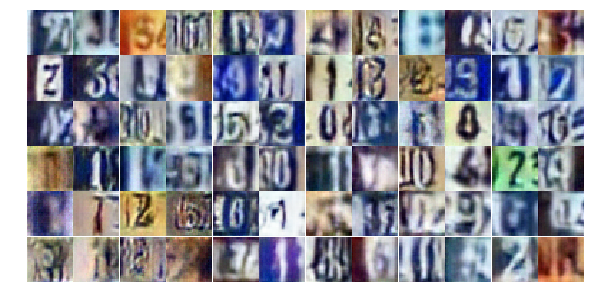

Epoch 12/25... Discriminator Loss: 0.4896... Generator Loss: 1.6116
Epoch 12/25... Discriminator Loss: 0.8943... Generator Loss: 0.7234
Epoch 12/25... Discriminator Loss: 0.5108... Generator Loss: 1.4082
Epoch 12/25... Discriminator Loss: 0.5664... Generator Loss: 1.2195
Epoch 12/25... Discriminator Loss: 0.5508... Generator Loss: 1.5396
Epoch 12/25... Discriminator Loss: 1.0999... Generator Loss: 2.2274
Epoch 12/25... Discriminator Loss: 1.4661... Generator Loss: 0.3568
Epoch 12/25... Discriminator Loss: 0.4701... Generator Loss: 1.3836
Epoch 12/25... Discriminator Loss: 0.5788... Generator Loss: 1.3871
Epoch 12/25... Discriminator Loss: 0.7350... Generator Loss: 0.9633


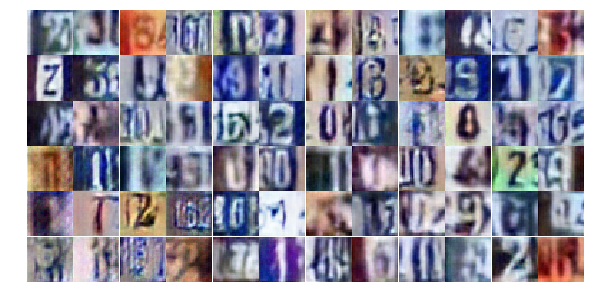

Epoch 12/25... Discriminator Loss: 0.3356... Generator Loss: 1.8790
Epoch 12/25... Discriminator Loss: 0.4262... Generator Loss: 1.9435
Epoch 12/25... Discriminator Loss: 0.5533... Generator Loss: 1.2682
Epoch 12/25... Discriminator Loss: 0.4536... Generator Loss: 1.3429
Epoch 12/25... Discriminator Loss: 0.3285... Generator Loss: 1.7767
Epoch 12/25... Discriminator Loss: 0.4756... Generator Loss: 1.3363
Epoch 12/25... Discriminator Loss: 0.4635... Generator Loss: 1.2824
Epoch 12/25... Discriminator Loss: 0.3522... Generator Loss: 1.9634
Epoch 12/25... Discriminator Loss: 0.5638... Generator Loss: 1.5271
Epoch 12/25... Discriminator Loss: 0.5834... Generator Loss: 1.2306


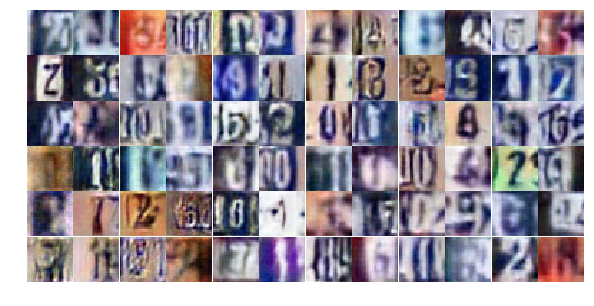

Epoch 12/25... Discriminator Loss: 0.5911... Generator Loss: 1.1152
Epoch 12/25... Discriminator Loss: 0.7739... Generator Loss: 0.8898
Epoch 12/25... Discriminator Loss: 0.8760... Generator Loss: 0.7234
Epoch 12/25... Discriminator Loss: 2.0203... Generator Loss: 0.2164
Epoch 12/25... Discriminator Loss: 0.7002... Generator Loss: 2.6002
Epoch 12/25... Discriminator Loss: 0.6604... Generator Loss: 1.1731
Epoch 12/25... Discriminator Loss: 1.0267... Generator Loss: 0.6030
Epoch 12/25... Discriminator Loss: 0.5944... Generator Loss: 1.6397
Epoch 12/25... Discriminator Loss: 0.7847... Generator Loss: 0.9357
Epoch 12/25... Discriminator Loss: 0.2451... Generator Loss: 2.1775


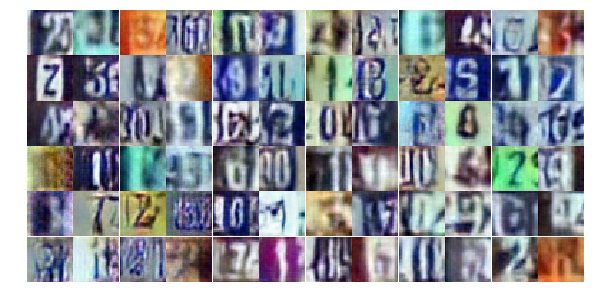

Epoch 12/25... Discriminator Loss: 0.5628... Generator Loss: 1.1000
Epoch 12/25... Discriminator Loss: 0.4385... Generator Loss: 1.3774
Epoch 12/25... Discriminator Loss: 0.4610... Generator Loss: 1.4817
Epoch 12/25... Discriminator Loss: 0.7001... Generator Loss: 1.1801
Epoch 12/25... Discriminator Loss: 0.7174... Generator Loss: 1.0836
Epoch 12/25... Discriminator Loss: 1.1971... Generator Loss: 0.4957
Epoch 12/25... Discriminator Loss: 0.5471... Generator Loss: 1.2860
Epoch 12/25... Discriminator Loss: 0.9165... Generator Loss: 0.7377
Epoch 12/25... Discriminator Loss: 1.1092... Generator Loss: 0.6544
Epoch 12/25... Discriminator Loss: 0.7206... Generator Loss: 1.7029


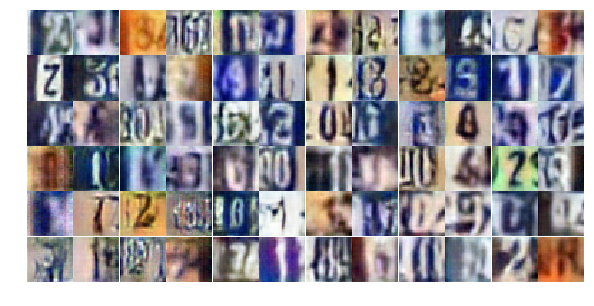

Epoch 12/25... Discriminator Loss: 0.9628... Generator Loss: 0.7050
Epoch 12/25... Discriminator Loss: 0.9274... Generator Loss: 0.7682
Epoch 12/25... Discriminator Loss: 1.6787... Generator Loss: 3.6263
Epoch 12/25... Discriminator Loss: 1.3737... Generator Loss: 0.4860
Epoch 12/25... Discriminator Loss: 0.4029... Generator Loss: 1.5733
Epoch 12/25... Discriminator Loss: 1.0166... Generator Loss: 2.6467
Epoch 12/25... Discriminator Loss: 0.7019... Generator Loss: 0.9602
Epoch 13/25... Discriminator Loss: 0.5793... Generator Loss: 1.5844
Epoch 13/25... Discriminator Loss: 0.4452... Generator Loss: 1.5933
Epoch 13/25... Discriminator Loss: 0.8434... Generator Loss: 0.8721


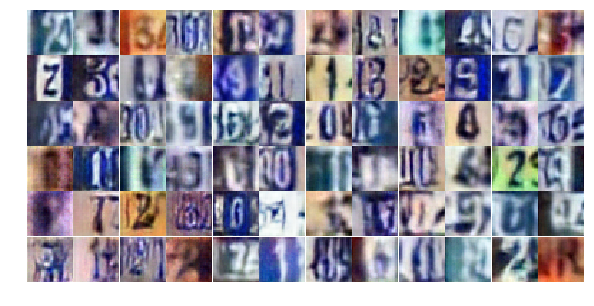

Epoch 13/25... Discriminator Loss: 0.5954... Generator Loss: 1.2021
Epoch 13/25... Discriminator Loss: 0.4452... Generator Loss: 1.6737
Epoch 13/25... Discriminator Loss: 0.9138... Generator Loss: 2.0085
Epoch 13/25... Discriminator Loss: 1.4295... Generator Loss: 0.5887
Epoch 13/25... Discriminator Loss: 0.6645... Generator Loss: 1.1047
Epoch 13/25... Discriminator Loss: 0.6704... Generator Loss: 1.0752
Epoch 13/25... Discriminator Loss: 0.5021... Generator Loss: 1.2821
Epoch 13/25... Discriminator Loss: 0.5931... Generator Loss: 1.1318
Epoch 13/25... Discriminator Loss: 0.6192... Generator Loss: 1.0914
Epoch 13/25... Discriminator Loss: 0.6587... Generator Loss: 1.0114


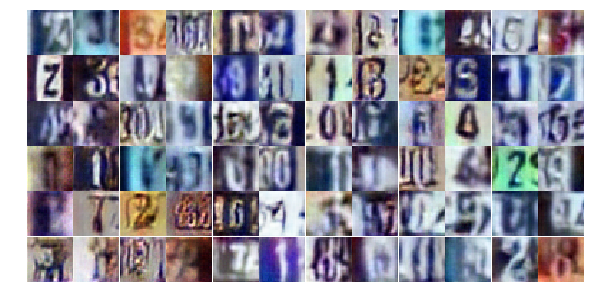

Epoch 13/25... Discriminator Loss: 0.7343... Generator Loss: 0.9108
Epoch 13/25... Discriminator Loss: 0.4537... Generator Loss: 1.5134
Epoch 13/25... Discriminator Loss: 1.4510... Generator Loss: 0.3704
Epoch 13/25... Discriminator Loss: 0.7775... Generator Loss: 0.9032
Epoch 13/25... Discriminator Loss: 0.5977... Generator Loss: 1.3764
Epoch 13/25... Discriminator Loss: 0.8662... Generator Loss: 0.8750
Epoch 13/25... Discriminator Loss: 0.5506... Generator Loss: 1.5754
Epoch 13/25... Discriminator Loss: 1.0809... Generator Loss: 0.5802
Epoch 13/25... Discriminator Loss: 0.6170... Generator Loss: 1.0489
Epoch 13/25... Discriminator Loss: 1.1576... Generator Loss: 0.5137


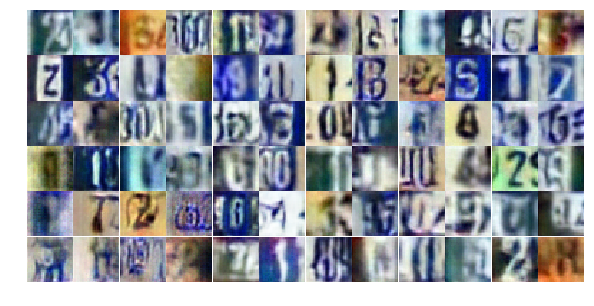

Epoch 13/25... Discriminator Loss: 0.6061... Generator Loss: 1.2098
Epoch 13/25... Discriminator Loss: 0.4605... Generator Loss: 1.7046
Epoch 13/25... Discriminator Loss: 0.6660... Generator Loss: 1.3707
Epoch 13/25... Discriminator Loss: 0.5405... Generator Loss: 1.2390
Epoch 13/25... Discriminator Loss: 0.6743... Generator Loss: 1.5607
Epoch 13/25... Discriminator Loss: 0.8239... Generator Loss: 0.8796
Epoch 13/25... Discriminator Loss: 0.8456... Generator Loss: 2.2944
Epoch 13/25... Discriminator Loss: 0.5928... Generator Loss: 1.2314
Epoch 13/25... Discriminator Loss: 0.5422... Generator Loss: 1.3762
Epoch 13/25... Discriminator Loss: 0.4721... Generator Loss: 1.7799


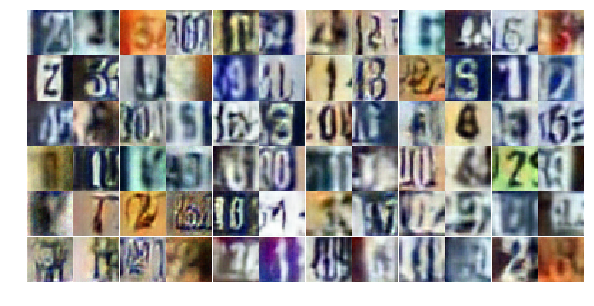

Epoch 13/25... Discriminator Loss: 1.0527... Generator Loss: 0.5989
Epoch 13/25... Discriminator Loss: 1.1381... Generator Loss: 0.6729
Epoch 13/25... Discriminator Loss: 0.8775... Generator Loss: 0.7184
Epoch 13/25... Discriminator Loss: 0.9735... Generator Loss: 0.7099
Epoch 13/25... Discriminator Loss: 0.5159... Generator Loss: 1.3637
Epoch 13/25... Discriminator Loss: 0.5154... Generator Loss: 1.3949
Epoch 13/25... Discriminator Loss: 0.4865... Generator Loss: 1.2389
Epoch 13/25... Discriminator Loss: 0.7261... Generator Loss: 1.0206
Epoch 13/25... Discriminator Loss: 0.5776... Generator Loss: 1.1315
Epoch 13/25... Discriminator Loss: 0.5952... Generator Loss: 1.2043


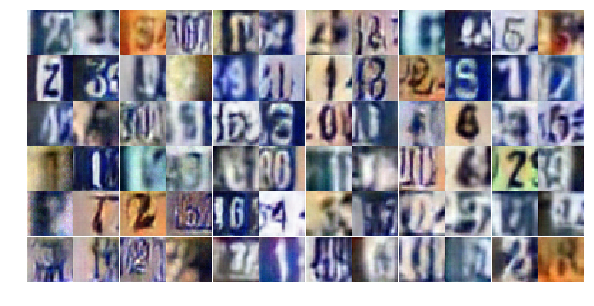

Epoch 13/25... Discriminator Loss: 0.5748... Generator Loss: 1.3174
Epoch 13/25... Discriminator Loss: 0.7811... Generator Loss: 0.8786
Epoch 13/25... Discriminator Loss: 0.5247... Generator Loss: 2.1943
Epoch 13/25... Discriminator Loss: 0.6350... Generator Loss: 1.3912
Epoch 13/25... Discriminator Loss: 1.0083... Generator Loss: 0.6426
Epoch 13/25... Discriminator Loss: 0.5894... Generator Loss: 1.4315
Epoch 13/25... Discriminator Loss: 0.7862... Generator Loss: 0.8990
Epoch 13/25... Discriminator Loss: 0.7511... Generator Loss: 0.9080
Epoch 13/25... Discriminator Loss: 0.9086... Generator Loss: 0.6856
Epoch 13/25... Discriminator Loss: 0.7002... Generator Loss: 0.9345


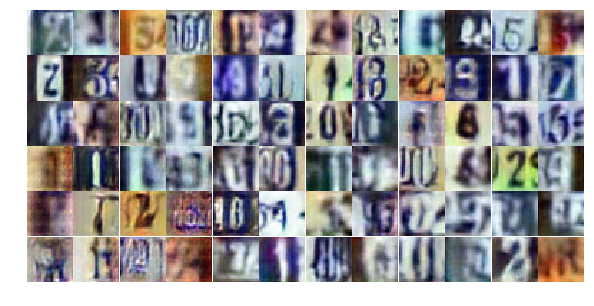

Epoch 13/25... Discriminator Loss: 0.3856... Generator Loss: 2.4255
Epoch 13/25... Discriminator Loss: 0.8592... Generator Loss: 0.7718
Epoch 13/25... Discriminator Loss: 0.5548... Generator Loss: 1.1750
Epoch 13/25... Discriminator Loss: 0.9745... Generator Loss: 0.6913
Epoch 14/25... Discriminator Loss: 0.6058... Generator Loss: 1.3055
Epoch 14/25... Discriminator Loss: 0.5814... Generator Loss: 1.2525
Epoch 14/25... Discriminator Loss: 0.7009... Generator Loss: 1.4564
Epoch 14/25... Discriminator Loss: 0.4902... Generator Loss: 1.9675
Epoch 14/25... Discriminator Loss: 0.4877... Generator Loss: 1.2596
Epoch 14/25... Discriminator Loss: 1.6670... Generator Loss: 0.3288


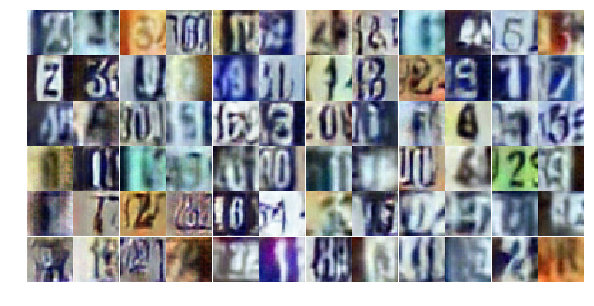

Epoch 14/25... Discriminator Loss: 0.7808... Generator Loss: 1.8458
Epoch 14/25... Discriminator Loss: 0.8409... Generator Loss: 0.9107
Epoch 14/25... Discriminator Loss: 0.6697... Generator Loss: 1.1106
Epoch 14/25... Discriminator Loss: 0.6016... Generator Loss: 1.2445
Epoch 14/25... Discriminator Loss: 1.0752... Generator Loss: 0.5741
Epoch 14/25... Discriminator Loss: 0.3246... Generator Loss: 1.7427
Epoch 14/25... Discriminator Loss: 0.5571... Generator Loss: 1.3833
Epoch 14/25... Discriminator Loss: 1.1363... Generator Loss: 0.5263
Epoch 14/25... Discriminator Loss: 0.8844... Generator Loss: 0.7055
Epoch 14/25... Discriminator Loss: 1.2524... Generator Loss: 0.5896


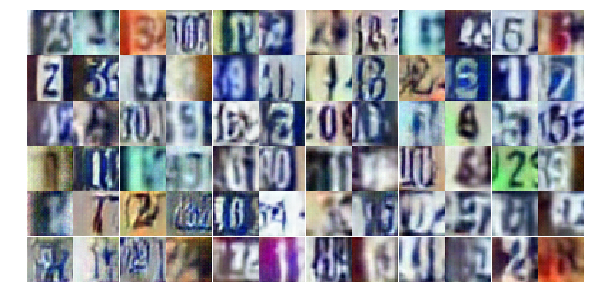

Epoch 14/25... Discriminator Loss: 0.6734... Generator Loss: 0.9457
Epoch 14/25... Discriminator Loss: 1.0389... Generator Loss: 3.0288
Epoch 14/25... Discriminator Loss: 2.0939... Generator Loss: 3.3332
Epoch 14/25... Discriminator Loss: 0.7622... Generator Loss: 0.9122
Epoch 14/25... Discriminator Loss: 0.8065... Generator Loss: 1.2495
Epoch 14/25... Discriminator Loss: 0.8003... Generator Loss: 0.9186
Epoch 14/25... Discriminator Loss: 0.9369... Generator Loss: 0.8366
Epoch 14/25... Discriminator Loss: 0.6196... Generator Loss: 1.1171
Epoch 14/25... Discriminator Loss: 0.6194... Generator Loss: 1.0927
Epoch 14/25... Discriminator Loss: 0.6011... Generator Loss: 1.2698


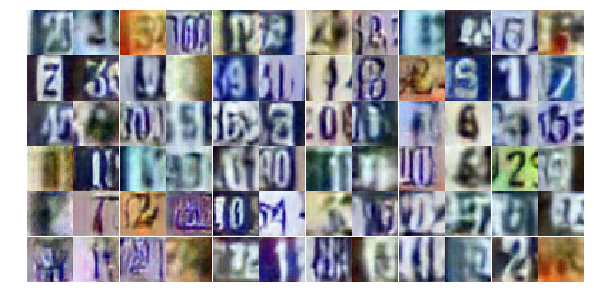

Epoch 14/25... Discriminator Loss: 1.4102... Generator Loss: 0.4011
Epoch 14/25... Discriminator Loss: 0.5259... Generator Loss: 1.2570
Epoch 14/25... Discriminator Loss: 0.5212... Generator Loss: 1.3795
Epoch 14/25... Discriminator Loss: 0.4684... Generator Loss: 1.4944
Epoch 14/25... Discriminator Loss: 0.5767... Generator Loss: 1.1918
Epoch 14/25... Discriminator Loss: 0.6951... Generator Loss: 1.0039
Epoch 14/25... Discriminator Loss: 0.8387... Generator Loss: 0.8584
Epoch 14/25... Discriminator Loss: 0.4840... Generator Loss: 1.2439
Epoch 14/25... Discriminator Loss: 0.4909... Generator Loss: 2.5160
Epoch 14/25... Discriminator Loss: 0.5705... Generator Loss: 1.3801


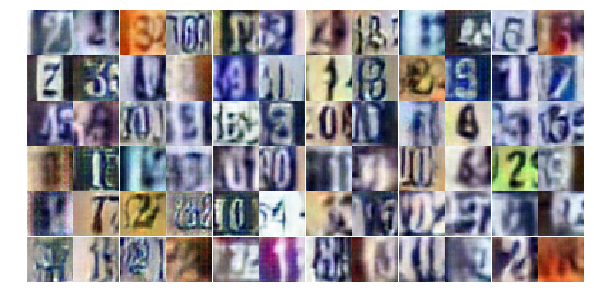

Epoch 14/25... Discriminator Loss: 1.2499... Generator Loss: 0.5178
Epoch 14/25... Discriminator Loss: 0.7381... Generator Loss: 1.1680
Epoch 14/25... Discriminator Loss: 0.6805... Generator Loss: 0.9839
Epoch 14/25... Discriminator Loss: 1.1028... Generator Loss: 0.5893
Epoch 14/25... Discriminator Loss: 1.1463... Generator Loss: 0.5371
Epoch 14/25... Discriminator Loss: 0.5697... Generator Loss: 1.6668
Epoch 14/25... Discriminator Loss: 0.7200... Generator Loss: 0.9059
Epoch 14/25... Discriminator Loss: 0.5409... Generator Loss: 1.2610
Epoch 14/25... Discriminator Loss: 1.3371... Generator Loss: 0.4899
Epoch 14/25... Discriminator Loss: 1.4373... Generator Loss: 0.4185


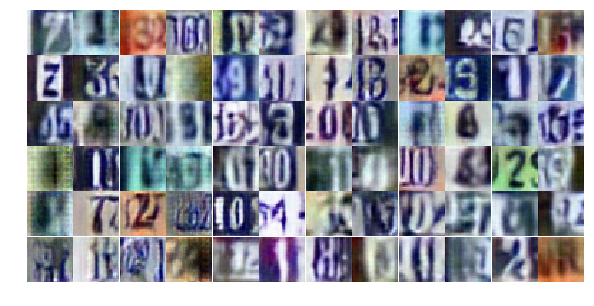

Epoch 14/25... Discriminator Loss: 0.8052... Generator Loss: 1.2375
Epoch 14/25... Discriminator Loss: 1.1883... Generator Loss: 0.5368
Epoch 14/25... Discriminator Loss: 0.4989... Generator Loss: 1.4396
Epoch 14/25... Discriminator Loss: 0.7884... Generator Loss: 0.8676
Epoch 14/25... Discriminator Loss: 0.5349... Generator Loss: 1.2695
Epoch 14/25... Discriminator Loss: 0.7380... Generator Loss: 0.9211
Epoch 14/25... Discriminator Loss: 0.9785... Generator Loss: 0.6868
Epoch 14/25... Discriminator Loss: 0.6443... Generator Loss: 1.1395
Epoch 14/25... Discriminator Loss: 1.0970... Generator Loss: 0.5514
Epoch 14/25... Discriminator Loss: 1.1768... Generator Loss: 0.5170


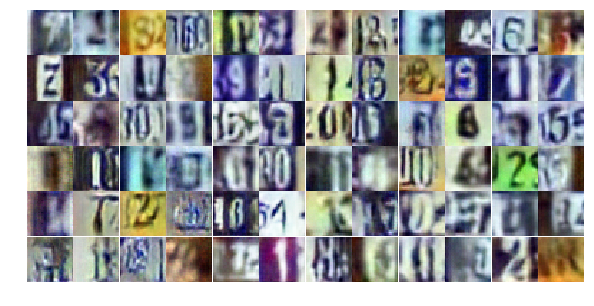

Epoch 14/25... Discriminator Loss: 1.2218... Generator Loss: 0.5251
Epoch 14/25... Discriminator Loss: 0.8375... Generator Loss: 0.8432
Epoch 15/25... Discriminator Loss: 0.6210... Generator Loss: 1.0781
Epoch 15/25... Discriminator Loss: 0.5187... Generator Loss: 1.3963
Epoch 15/25... Discriminator Loss: 0.6579... Generator Loss: 1.1000
Epoch 15/25... Discriminator Loss: 0.9659... Generator Loss: 0.6981
Epoch 15/25... Discriminator Loss: 0.8560... Generator Loss: 0.7907
Epoch 15/25... Discriminator Loss: 0.6650... Generator Loss: 1.3265
Epoch 15/25... Discriminator Loss: 1.2016... Generator Loss: 0.4908
Epoch 15/25... Discriminator Loss: 0.6504... Generator Loss: 1.2407


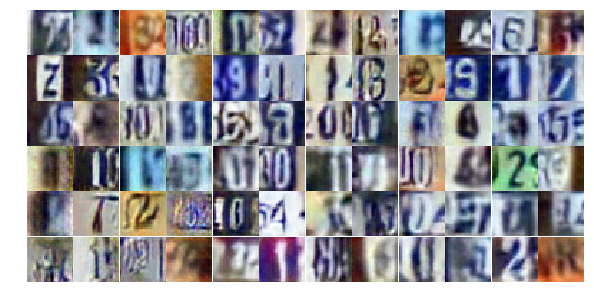

Epoch 15/25... Discriminator Loss: 0.8847... Generator Loss: 0.7522
Epoch 15/25... Discriminator Loss: 0.5075... Generator Loss: 1.6225
Epoch 15/25... Discriminator Loss: 0.7461... Generator Loss: 0.8892
Epoch 15/25... Discriminator Loss: 0.7017... Generator Loss: 1.0988
Epoch 15/25... Discriminator Loss: 0.6909... Generator Loss: 1.1273
Epoch 15/25... Discriminator Loss: 0.5371... Generator Loss: 1.2336
Epoch 15/25... Discriminator Loss: 1.4931... Generator Loss: 0.3600
Epoch 15/25... Discriminator Loss: 2.3704... Generator Loss: 3.7053
Epoch 15/25... Discriminator Loss: 0.6875... Generator Loss: 3.5460
Epoch 15/25... Discriminator Loss: 1.6075... Generator Loss: 0.3305


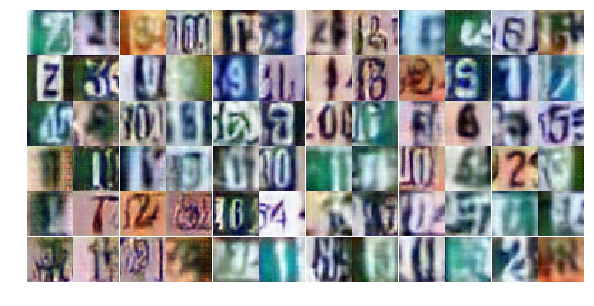

Epoch 15/25... Discriminator Loss: 1.1645... Generator Loss: 0.5658
Epoch 15/25... Discriminator Loss: 0.5883... Generator Loss: 1.1297
Epoch 15/25... Discriminator Loss: 0.6493... Generator Loss: 1.1146
Epoch 15/25... Discriminator Loss: 0.7497... Generator Loss: 1.2657
Epoch 15/25... Discriminator Loss: 1.0327... Generator Loss: 0.7442
Epoch 15/25... Discriminator Loss: 0.7455... Generator Loss: 1.0078
Epoch 15/25... Discriminator Loss: 1.0804... Generator Loss: 0.6343
Epoch 15/25... Discriminator Loss: 0.5161... Generator Loss: 1.2379
Epoch 15/25... Discriminator Loss: 0.6141... Generator Loss: 1.1664
Epoch 15/25... Discriminator Loss: 1.5842... Generator Loss: 0.3280


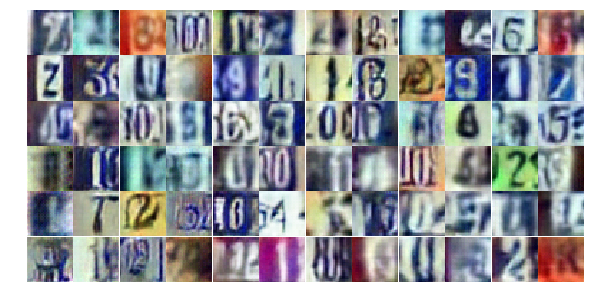

Epoch 15/25... Discriminator Loss: 0.8252... Generator Loss: 0.8130
Epoch 15/25... Discriminator Loss: 0.6801... Generator Loss: 1.4940
Epoch 15/25... Discriminator Loss: 0.3591... Generator Loss: 1.7189
Epoch 15/25... Discriminator Loss: 0.6388... Generator Loss: 1.0946
Epoch 15/25... Discriminator Loss: 0.6208... Generator Loss: 1.1072
Epoch 15/25... Discriminator Loss: 0.6926... Generator Loss: 1.7580
Epoch 15/25... Discriminator Loss: 0.4359... Generator Loss: 1.8995
Epoch 15/25... Discriminator Loss: 0.7222... Generator Loss: 1.0253
Epoch 15/25... Discriminator Loss: 0.5481... Generator Loss: 1.2546
Epoch 15/25... Discriminator Loss: 0.6418... Generator Loss: 1.0792


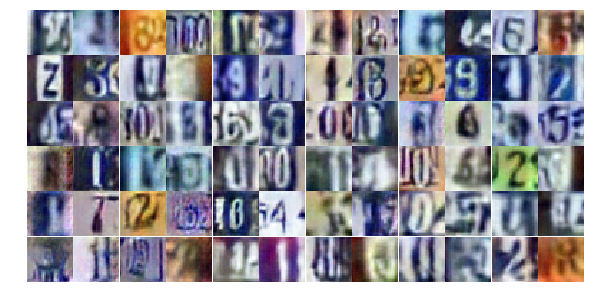

Epoch 15/25... Discriminator Loss: 0.6312... Generator Loss: 1.1182
Epoch 15/25... Discriminator Loss: 1.5288... Generator Loss: 0.3339
Epoch 15/25... Discriminator Loss: 0.6789... Generator Loss: 1.0583
Epoch 15/25... Discriminator Loss: 0.4806... Generator Loss: 1.3759
Epoch 15/25... Discriminator Loss: 0.7914... Generator Loss: 0.8133
Epoch 15/25... Discriminator Loss: 1.9559... Generator Loss: 0.2320
Epoch 15/25... Discriminator Loss: 1.0505... Generator Loss: 1.6744
Epoch 15/25... Discriminator Loss: 0.8606... Generator Loss: 1.5807
Epoch 15/25... Discriminator Loss: 0.7686... Generator Loss: 0.8586
Epoch 15/25... Discriminator Loss: 0.8971... Generator Loss: 0.7575


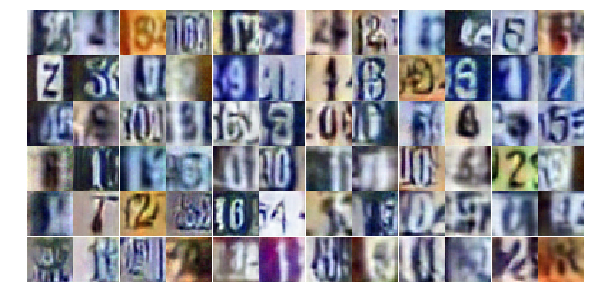

Epoch 15/25... Discriminator Loss: 0.8637... Generator Loss: 0.7725
Epoch 15/25... Discriminator Loss: 1.0028... Generator Loss: 0.6325
Epoch 15/25... Discriminator Loss: 0.4886... Generator Loss: 1.3130
Epoch 15/25... Discriminator Loss: 1.1403... Generator Loss: 0.6057
Epoch 15/25... Discriminator Loss: 0.5721... Generator Loss: 1.2100
Epoch 15/25... Discriminator Loss: 0.8776... Generator Loss: 1.4758
Epoch 15/25... Discriminator Loss: 0.8347... Generator Loss: 0.7920
Epoch 15/25... Discriminator Loss: 0.4657... Generator Loss: 2.1118
Epoch 15/25... Discriminator Loss: 0.9935... Generator Loss: 0.7013
Epoch 16/25... Discriminator Loss: 0.9697... Generator Loss: 0.6448


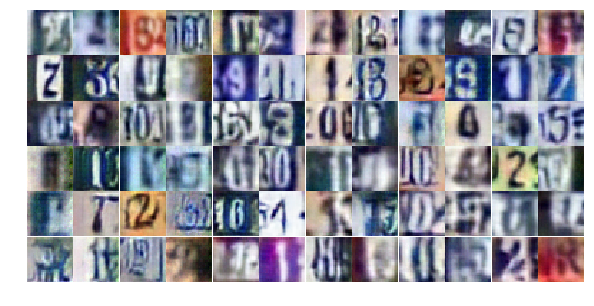

Epoch 16/25... Discriminator Loss: 0.6727... Generator Loss: 1.0217
Epoch 16/25... Discriminator Loss: 0.6989... Generator Loss: 1.2409
Epoch 16/25... Discriminator Loss: 1.1438... Generator Loss: 0.5674
Epoch 16/25... Discriminator Loss: 0.8244... Generator Loss: 0.9277
Epoch 16/25... Discriminator Loss: 0.6165... Generator Loss: 1.6825
Epoch 16/25... Discriminator Loss: 0.6363... Generator Loss: 1.2278
Epoch 16/25... Discriminator Loss: 1.4949... Generator Loss: 0.3500
Epoch 16/25... Discriminator Loss: 0.8305... Generator Loss: 0.8637
Epoch 16/25... Discriminator Loss: 0.6332... Generator Loss: 0.9939
Epoch 16/25... Discriminator Loss: 0.5545... Generator Loss: 1.1673


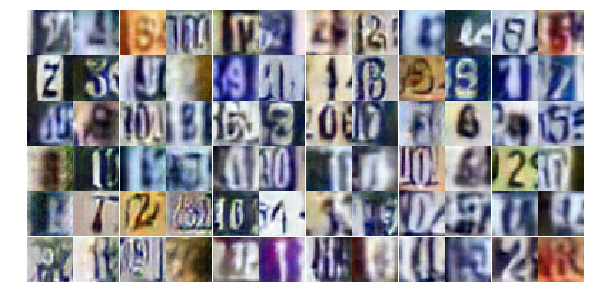

Epoch 16/25... Discriminator Loss: 1.4841... Generator Loss: 0.3588
Epoch 16/25... Discriminator Loss: 0.7483... Generator Loss: 0.9475
Epoch 16/25... Discriminator Loss: 0.6034... Generator Loss: 1.2440
Epoch 16/25... Discriminator Loss: 1.3600... Generator Loss: 0.4068
Epoch 16/25... Discriminator Loss: 0.4505... Generator Loss: 2.1665
Epoch 16/25... Discriminator Loss: 1.2254... Generator Loss: 0.4757
Epoch 16/25... Discriminator Loss: 1.0609... Generator Loss: 0.8516
Epoch 16/25... Discriminator Loss: 0.3950... Generator Loss: 2.0680
Epoch 16/25... Discriminator Loss: 0.6187... Generator Loss: 1.0274
Epoch 16/25... Discriminator Loss: 0.5762... Generator Loss: 1.2238


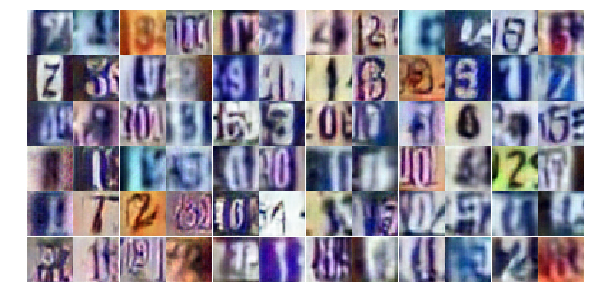

Epoch 16/25... Discriminator Loss: 0.9066... Generator Loss: 0.7336
Epoch 16/25... Discriminator Loss: 0.6530... Generator Loss: 1.1033
Epoch 16/25... Discriminator Loss: 0.8441... Generator Loss: 0.8950
Epoch 16/25... Discriminator Loss: 1.3464... Generator Loss: 0.4300
Epoch 16/25... Discriminator Loss: 0.7294... Generator Loss: 1.0736
Epoch 16/25... Discriminator Loss: 0.9047... Generator Loss: 0.8873
Epoch 16/25... Discriminator Loss: 0.7326... Generator Loss: 0.8988
Epoch 16/25... Discriminator Loss: 0.6397... Generator Loss: 1.0598
Epoch 16/25... Discriminator Loss: 0.7547... Generator Loss: 1.0252
Epoch 16/25... Discriminator Loss: 0.5836... Generator Loss: 1.2788


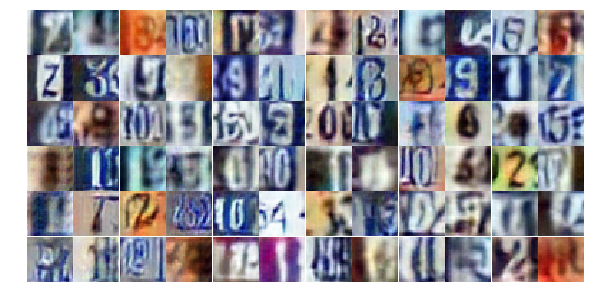

Epoch 16/25... Discriminator Loss: 0.5735... Generator Loss: 1.1358
Epoch 16/25... Discriminator Loss: 0.6313... Generator Loss: 1.1020
Epoch 16/25... Discriminator Loss: 0.6436... Generator Loss: 1.1437
Epoch 16/25... Discriminator Loss: 0.8693... Generator Loss: 0.9024
Epoch 16/25... Discriminator Loss: 0.7537... Generator Loss: 1.1977
Epoch 16/25... Discriminator Loss: 0.5906... Generator Loss: 1.2517
Epoch 16/25... Discriminator Loss: 0.8174... Generator Loss: 0.8580
Epoch 16/25... Discriminator Loss: 1.1873... Generator Loss: 0.4777
Epoch 16/25... Discriminator Loss: 1.0375... Generator Loss: 0.6336
Epoch 16/25... Discriminator Loss: 0.5186... Generator Loss: 1.4283


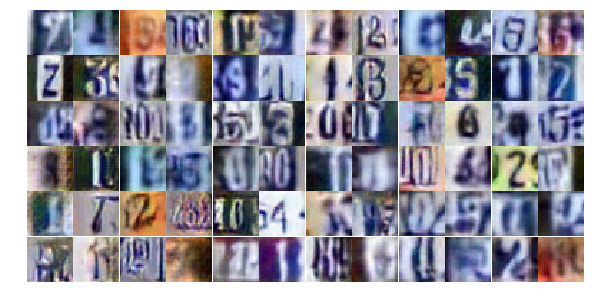

Epoch 16/25... Discriminator Loss: 0.6625... Generator Loss: 1.0288
Epoch 16/25... Discriminator Loss: 0.5494... Generator Loss: 1.3789
Epoch 16/25... Discriminator Loss: 0.8855... Generator Loss: 0.7557
Epoch 16/25... Discriminator Loss: 0.7351... Generator Loss: 1.5820
Epoch 16/25... Discriminator Loss: 0.9471... Generator Loss: 0.6938
Epoch 16/25... Discriminator Loss: 1.1132... Generator Loss: 0.5907
Epoch 16/25... Discriminator Loss: 0.7180... Generator Loss: 1.8148
Epoch 16/25... Discriminator Loss: 0.8691... Generator Loss: 0.8183
Epoch 16/25... Discriminator Loss: 0.4050... Generator Loss: 1.6767
Epoch 16/25... Discriminator Loss: 0.9531... Generator Loss: 0.7323


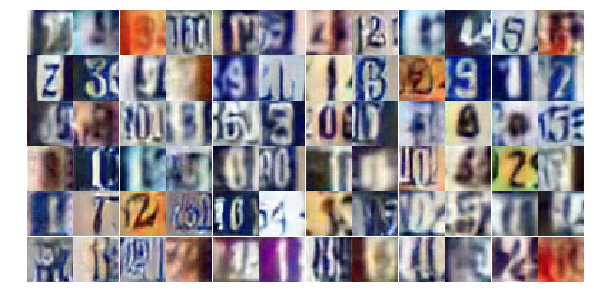

Epoch 16/25... Discriminator Loss: 1.0124... Generator Loss: 0.7760
Epoch 16/25... Discriminator Loss: 0.6441... Generator Loss: 1.0565
Epoch 16/25... Discriminator Loss: 1.8058... Generator Loss: 0.2789
Epoch 16/25... Discriminator Loss: 0.3777... Generator Loss: 1.9813
Epoch 16/25... Discriminator Loss: 0.4885... Generator Loss: 1.5414
Epoch 16/25... Discriminator Loss: 0.6056... Generator Loss: 1.2431
Epoch 17/25... Discriminator Loss: 0.4708... Generator Loss: 1.7431
Epoch 17/25... Discriminator Loss: 0.7865... Generator Loss: 0.9444
Epoch 17/25... Discriminator Loss: 0.6907... Generator Loss: 1.1283
Epoch 17/25... Discriminator Loss: 0.7368... Generator Loss: 0.9630


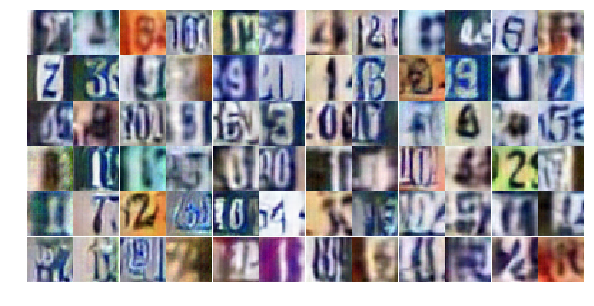

Epoch 17/25... Discriminator Loss: 0.5238... Generator Loss: 1.1478
Epoch 17/25... Discriminator Loss: 0.5457... Generator Loss: 1.2082
Epoch 17/25... Discriminator Loss: 0.6022... Generator Loss: 1.1576
Epoch 17/25... Discriminator Loss: 0.7652... Generator Loss: 0.9084
Epoch 17/25... Discriminator Loss: 1.0330... Generator Loss: 0.6230
Epoch 17/25... Discriminator Loss: 1.5933... Generator Loss: 0.3259
Epoch 17/25... Discriminator Loss: 0.8183... Generator Loss: 0.9427
Epoch 17/25... Discriminator Loss: 0.7274... Generator Loss: 0.9546
Epoch 17/25... Discriminator Loss: 0.5456... Generator Loss: 1.2525
Epoch 17/25... Discriminator Loss: 0.6818... Generator Loss: 2.3739


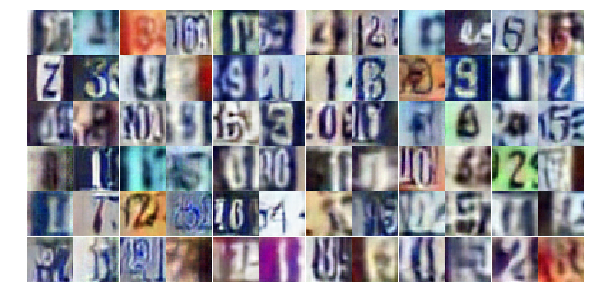

Epoch 17/25... Discriminator Loss: 2.1744... Generator Loss: 3.9298
Epoch 17/25... Discriminator Loss: 0.9599... Generator Loss: 1.3921
Epoch 17/25... Discriminator Loss: 0.7762... Generator Loss: 0.9314
Epoch 17/25... Discriminator Loss: 0.7815... Generator Loss: 1.2822
Epoch 17/25... Discriminator Loss: 0.6220... Generator Loss: 1.0774
Epoch 17/25... Discriminator Loss: 0.9239... Generator Loss: 0.6685
Epoch 17/25... Discriminator Loss: 0.5193... Generator Loss: 1.3799
Epoch 17/25... Discriminator Loss: 0.5090... Generator Loss: 1.3725
Epoch 17/25... Discriminator Loss: 0.8083... Generator Loss: 0.8275
Epoch 17/25... Discriminator Loss: 0.6196... Generator Loss: 1.1486


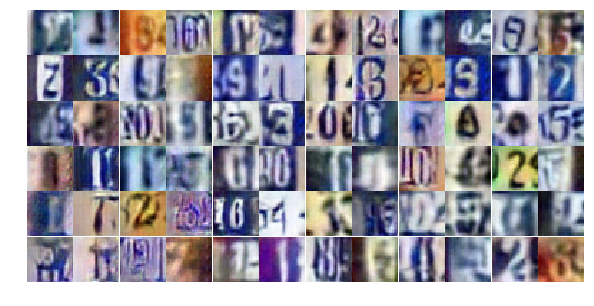

Epoch 17/25... Discriminator Loss: 1.6295... Generator Loss: 0.3596
Epoch 17/25... Discriminator Loss: 0.4863... Generator Loss: 1.4425
Epoch 17/25... Discriminator Loss: 0.5351... Generator Loss: 1.1877
Epoch 17/25... Discriminator Loss: 1.2468... Generator Loss: 0.4766
Epoch 17/25... Discriminator Loss: 1.1685... Generator Loss: 0.4924
Epoch 17/25... Discriminator Loss: 0.4791... Generator Loss: 1.4357
Epoch 17/25... Discriminator Loss: 0.8988... Generator Loss: 0.7303
Epoch 17/25... Discriminator Loss: 0.8829... Generator Loss: 0.7254
Epoch 17/25... Discriminator Loss: 1.1568... Generator Loss: 0.5376
Epoch 17/25... Discriminator Loss: 0.3418... Generator Loss: 2.0495


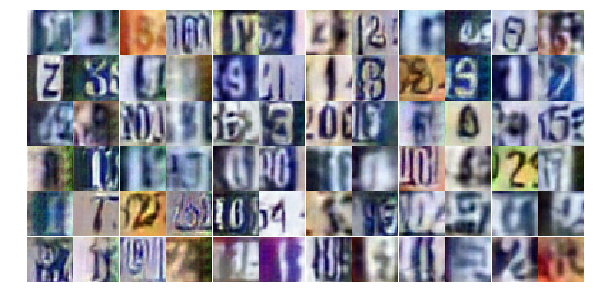

Epoch 17/25... Discriminator Loss: 0.6120... Generator Loss: 1.1378
Epoch 17/25... Discriminator Loss: 1.4640... Generator Loss: 0.4013
Epoch 17/25... Discriminator Loss: 0.6088... Generator Loss: 1.3407
Epoch 17/25... Discriminator Loss: 0.5832... Generator Loss: 1.8308
Epoch 17/25... Discriminator Loss: 0.7206... Generator Loss: 1.0356
Epoch 17/25... Discriminator Loss: 0.7241... Generator Loss: 0.8708
Epoch 17/25... Discriminator Loss: 0.9877... Generator Loss: 0.6780
Epoch 17/25... Discriminator Loss: 0.5544... Generator Loss: 1.2025
Epoch 17/25... Discriminator Loss: 0.3214... Generator Loss: 1.9822
Epoch 17/25... Discriminator Loss: 0.5557... Generator Loss: 1.2071


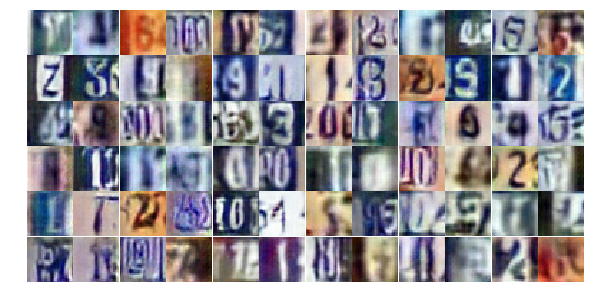

Epoch 17/25... Discriminator Loss: 1.7571... Generator Loss: 2.1171
Epoch 17/25... Discriminator Loss: 0.3385... Generator Loss: 2.2333
Epoch 17/25... Discriminator Loss: 0.9973... Generator Loss: 2.2862
Epoch 17/25... Discriminator Loss: 0.4607... Generator Loss: 1.3604
Epoch 17/25... Discriminator Loss: 0.8674... Generator Loss: 0.8177
Epoch 17/25... Discriminator Loss: 0.8825... Generator Loss: 0.7811
Epoch 17/25... Discriminator Loss: 1.0164... Generator Loss: 0.6593
Epoch 17/25... Discriminator Loss: 0.7598... Generator Loss: 0.8988
Epoch 17/25... Discriminator Loss: 0.5365... Generator Loss: 1.4870
Epoch 17/25... Discriminator Loss: 1.0301... Generator Loss: 0.6316


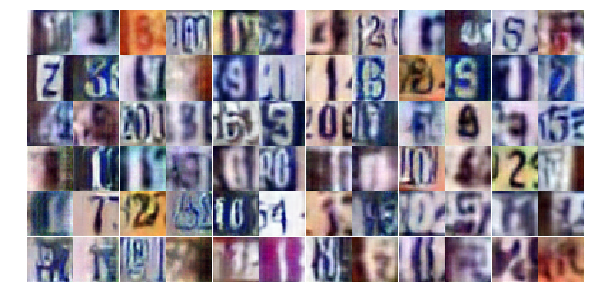

Epoch 17/25... Discriminator Loss: 0.8432... Generator Loss: 1.1657
Epoch 17/25... Discriminator Loss: 1.2357... Generator Loss: 2.0523
Epoch 17/25... Discriminator Loss: 0.5100... Generator Loss: 1.3126
Epoch 17/25... Discriminator Loss: 0.5797... Generator Loss: 1.4050
Epoch 18/25... Discriminator Loss: 0.9431... Generator Loss: 0.7660
Epoch 18/25... Discriminator Loss: 0.8595... Generator Loss: 0.8164
Epoch 18/25... Discriminator Loss: 0.8214... Generator Loss: 0.8893
Epoch 18/25... Discriminator Loss: 0.7249... Generator Loss: 0.8821
Epoch 18/25... Discriminator Loss: 1.0231... Generator Loss: 0.6706
Epoch 18/25... Discriminator Loss: 0.7446... Generator Loss: 1.0344


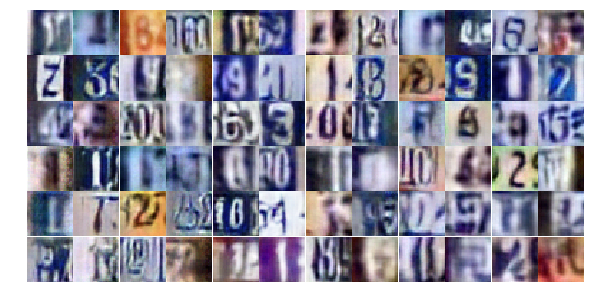

Epoch 18/25... Discriminator Loss: 0.3452... Generator Loss: 2.0217
Epoch 18/25... Discriminator Loss: 1.3021... Generator Loss: 0.4536
Epoch 18/25... Discriminator Loss: 1.0438... Generator Loss: 0.6232
Epoch 18/25... Discriminator Loss: 0.4484... Generator Loss: 1.6893
Epoch 18/25... Discriminator Loss: 0.7971... Generator Loss: 0.8608
Epoch 18/25... Discriminator Loss: 0.8603... Generator Loss: 0.8157
Epoch 18/25... Discriminator Loss: 0.6119... Generator Loss: 1.7971
Epoch 18/25... Discriminator Loss: 0.8812... Generator Loss: 0.7826
Epoch 18/25... Discriminator Loss: 0.4634... Generator Loss: 1.8161
Epoch 18/25... Discriminator Loss: 0.3735... Generator Loss: 1.8346


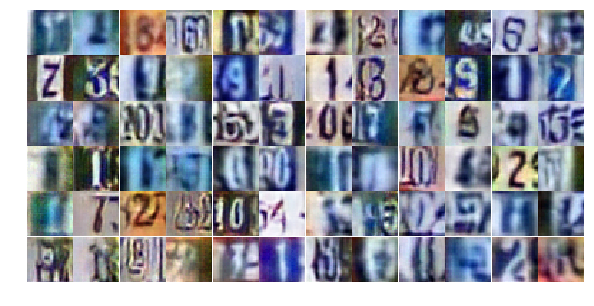

Epoch 18/25... Discriminator Loss: 0.4621... Generator Loss: 1.5842
Epoch 18/25... Discriminator Loss: 0.6686... Generator Loss: 1.8022
Epoch 18/25... Discriminator Loss: 1.1221... Generator Loss: 0.6479
Epoch 18/25... Discriminator Loss: 0.4797... Generator Loss: 1.4306
Epoch 18/25... Discriminator Loss: 0.8357... Generator Loss: 0.7689
Epoch 18/25... Discriminator Loss: 1.0632... Generator Loss: 0.5635
Epoch 18/25... Discriminator Loss: 0.7431... Generator Loss: 1.0947
Epoch 18/25... Discriminator Loss: 0.9821... Generator Loss: 0.6532
Epoch 18/25... Discriminator Loss: 0.7147... Generator Loss: 0.9334
Epoch 18/25... Discriminator Loss: 0.7112... Generator Loss: 0.9249


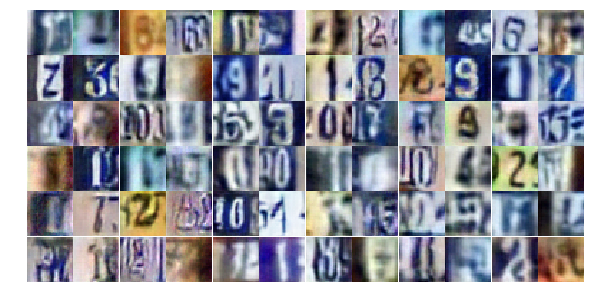

Epoch 18/25... Discriminator Loss: 0.5104... Generator Loss: 1.4435
Epoch 18/25... Discriminator Loss: 0.6835... Generator Loss: 3.0075
Epoch 18/25... Discriminator Loss: 0.6880... Generator Loss: 0.9852
Epoch 18/25... Discriminator Loss: 0.7662... Generator Loss: 1.0603
Epoch 18/25... Discriminator Loss: 1.1820... Generator Loss: 0.5040
Epoch 18/25... Discriminator Loss: 0.6142... Generator Loss: 1.1181
Epoch 18/25... Discriminator Loss: 0.8982... Generator Loss: 0.7997
Epoch 18/25... Discriminator Loss: 0.4820... Generator Loss: 1.5225
Epoch 18/25... Discriminator Loss: 0.5372... Generator Loss: 1.2134
Epoch 18/25... Discriminator Loss: 0.6757... Generator Loss: 1.0793


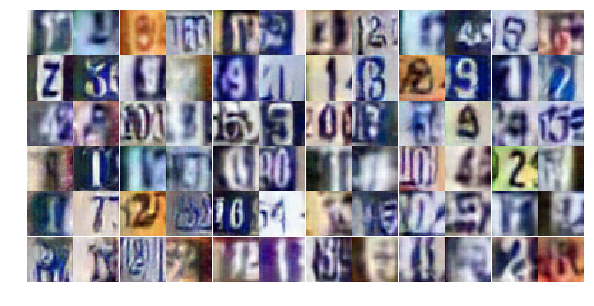

Epoch 18/25... Discriminator Loss: 0.5740... Generator Loss: 1.6330
Epoch 18/25... Discriminator Loss: 0.6368... Generator Loss: 1.0803
Epoch 18/25... Discriminator Loss: 0.5507... Generator Loss: 1.3329
Epoch 18/25... Discriminator Loss: 0.5856... Generator Loss: 1.1578
Epoch 18/25... Discriminator Loss: 0.7533... Generator Loss: 0.9746
Epoch 18/25... Discriminator Loss: 0.4505... Generator Loss: 1.4129
Epoch 18/25... Discriminator Loss: 0.8175... Generator Loss: 0.7790
Epoch 18/25... Discriminator Loss: 1.7139... Generator Loss: 3.5104
Epoch 18/25... Discriminator Loss: 1.3953... Generator Loss: 0.4473
Epoch 18/25... Discriminator Loss: 0.5132... Generator Loss: 1.3451


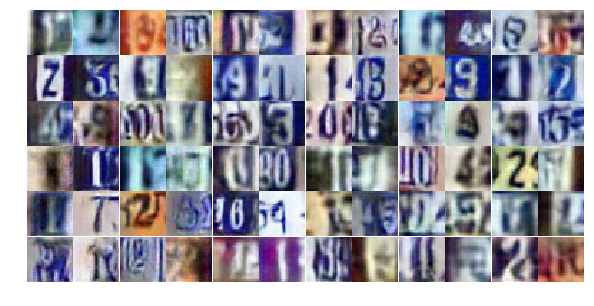

Epoch 18/25... Discriminator Loss: 0.7322... Generator Loss: 0.9116
Epoch 18/25... Discriminator Loss: 0.5252... Generator Loss: 1.9201
Epoch 18/25... Discriminator Loss: 0.6693... Generator Loss: 1.6624
Epoch 18/25... Discriminator Loss: 0.7769... Generator Loss: 1.0139
Epoch 18/25... Discriminator Loss: 0.5120... Generator Loss: 1.6542
Epoch 18/25... Discriminator Loss: 0.7918... Generator Loss: 0.9481
Epoch 18/25... Discriminator Loss: 0.5207... Generator Loss: 1.2673
Epoch 18/25... Discriminator Loss: 0.4081... Generator Loss: 1.8994
Epoch 18/25... Discriminator Loss: 0.9219... Generator Loss: 0.7727
Epoch 18/25... Discriminator Loss: 1.0838... Generator Loss: 0.5852


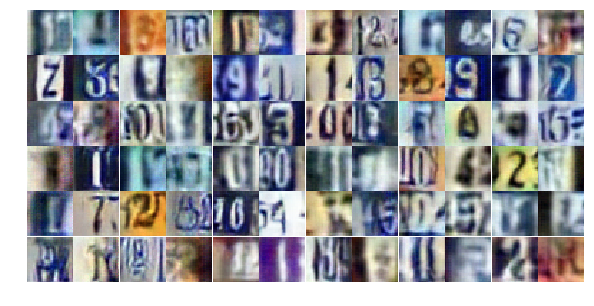

Epoch 18/25... Discriminator Loss: 0.6055... Generator Loss: 1.2523
Epoch 19/25... Discriminator Loss: 1.5086... Generator Loss: 2.1364
Epoch 19/25... Discriminator Loss: 0.8283... Generator Loss: 0.8034
Epoch 19/25... Discriminator Loss: 0.6824... Generator Loss: 1.1980
Epoch 19/25... Discriminator Loss: 0.5862... Generator Loss: 1.1613
Epoch 19/25... Discriminator Loss: 1.4568... Generator Loss: 0.3716
Epoch 19/25... Discriminator Loss: 0.5945... Generator Loss: 1.3049
Epoch 19/25... Discriminator Loss: 0.7589... Generator Loss: 0.9946
Epoch 19/25... Discriminator Loss: 0.5237... Generator Loss: 1.8302
Epoch 19/25... Discriminator Loss: 0.9998... Generator Loss: 0.7883


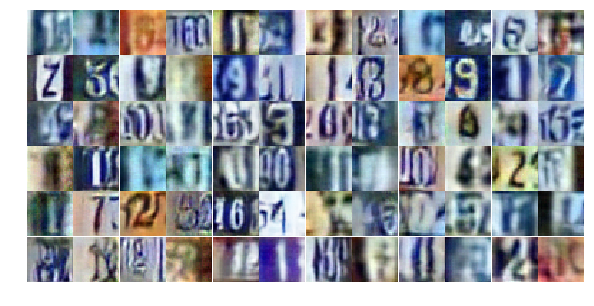

Epoch 19/25... Discriminator Loss: 0.7706... Generator Loss: 0.8411
Epoch 19/25... Discriminator Loss: 1.2052... Generator Loss: 0.4870
Epoch 19/25... Discriminator Loss: 0.7883... Generator Loss: 0.9377
Epoch 19/25... Discriminator Loss: 1.2118... Generator Loss: 0.4834
Epoch 19/25... Discriminator Loss: 0.9549... Generator Loss: 0.6803
Epoch 19/25... Discriminator Loss: 0.5610... Generator Loss: 1.1859
Epoch 19/25... Discriminator Loss: 0.9287... Generator Loss: 0.9014
Epoch 19/25... Discriminator Loss: 0.5764... Generator Loss: 1.6262
Epoch 19/25... Discriminator Loss: 0.7575... Generator Loss: 1.8218
Epoch 19/25... Discriminator Loss: 0.8282... Generator Loss: 0.9437


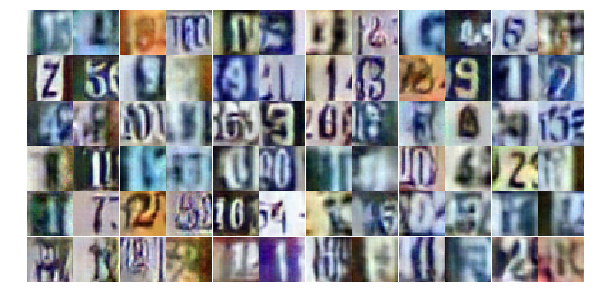

Epoch 19/25... Discriminator Loss: 0.8863... Generator Loss: 0.8364
Epoch 19/25... Discriminator Loss: 1.0785... Generator Loss: 0.6157


In [ ]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))